In [1]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
import pandas as pd
pd.options.display.float_format = '{:.2f}'.format

In [2]:
import pandas as pd
import math
import seaborn as sns
from matplotlib import pyplot as plt
import re
import numpy as np
import geopandas as gpd
from shapely.geometry import Point # Point class
from shapely.geometry import shape
import io
from geopy.geocoders import Nominatim
geolocator = Nominatim(user_agent="geoapiExercises")
from geopy.geocoders import Nominatim
from time import sleep
from datetime import datetime

C:\Users\Md Mintu Miah\anaconda3\envs\geo_env\lib\site-packages\geopandas\_compat.py:112: UserWarning: The Shapely GEOS version (3.11.0-CAPI-1.17.0) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  warnings.warn(


In [3]:
# read the daily Volume
doh_weekday_factor=pd.read_csv('C:/UC Berkeley Project Backup/Bike_ped Exposure Model Project/Processed Data/HOD_weekday.csv')
doh_weekend_factor=pd.read_csv('C:/UC Berkeley Project Backup/Bike_ped Exposure Model Project/Processed Data/HOD_weekend.csv')

In [4]:
# read the indices
ind=pd.read_csv('C:/UC Berkeley Project Backup/Bike_ped Exposure Model Project/Processed Data/Updated_indices.csv')
ind.head()

,Unnamed: 0.1,ID,year,Max_WWI,Average_WWI,Weekday_Aergage_AMI,Weekend_Aergage_AMI,Average AMI_wday_wend,Max_weekend_AMI,Max_weekday_AMI,...,state,country,Unnamed: 0,edgeUID,osmId,stv_total,stv_com_total,stv_rec_total,stv_com_ratio,stv_rec_ratio
0,0,671,2016,2.23,0.77,0.70,0.32,2.17,0.36,0.93,...,California,United States,0,308723101,215845474,NaN,NaN,NaN,NaN,NaN
1,1,671,2017,2.89,0.78,0.74,0.38,1.97,0.44,1.02,...,California,United States,0,308723101,215845474,NaN,NaN,NaN,NaN,NaN
2,2,671,2018,1.35,0.71,0.86,0.29,2.97,0.30,1.43,...,California,United States,0,308723101,215845474,4890.00,260.00,4630.00,0.05,0.95
3,3,671,2019,1.44,0.66,0.82,0.34,2.41,0.35,1.21,...,California,United States,0,308723101,215845474,4625.00,255.00,4370.00,0.06,0.94
4,4,1127,2016,2.22,0.26,2.05,0.58,3.51,0.74,2.24,...,California,United States,1,308779961,87297166,NaN,NaN,NaN,NaN,NaN


In [5]:
ind.columns

Index(['Unnamed: 0.1', 'ID', 'year', 'Max_WWI', 'Average_WWI',
       'Weekday_Aergage_AMI', 'Weekend_Aergage_AMI', 'Average AMI_wday_wend',
       'Max_weekend_AMI', 'Max_weekday_AMI', 'Daily_Max_AMI', 'Daily_Max_PMI',
       'Weekday_Aergage_PMI', 'Weekend_Aergage_PMI', 'Average PMI_wday_wend',
       'Max_weekday_PMI', 'Max_weekend_PMI', 'max_daily_am_pm',
       'max_daily_am/pm_value', 'max_weekend_am/pm', 'max_weekend_am_pm_Value',
       'max_weekday_am/pm', 'max_weekday_am_pm_value', 'seasonal_factor',
       'latitude', 'longitude', 'location', 'road', 'city', 'county', 'state',
       'country', 'Unnamed: 0', 'edgeUID', 'osmId', 'stv_total',
       'stv_com_total', 'stv_rec_total', 'stv_com_ratio', 'stv_rec_ratio'],
      dtype='object')

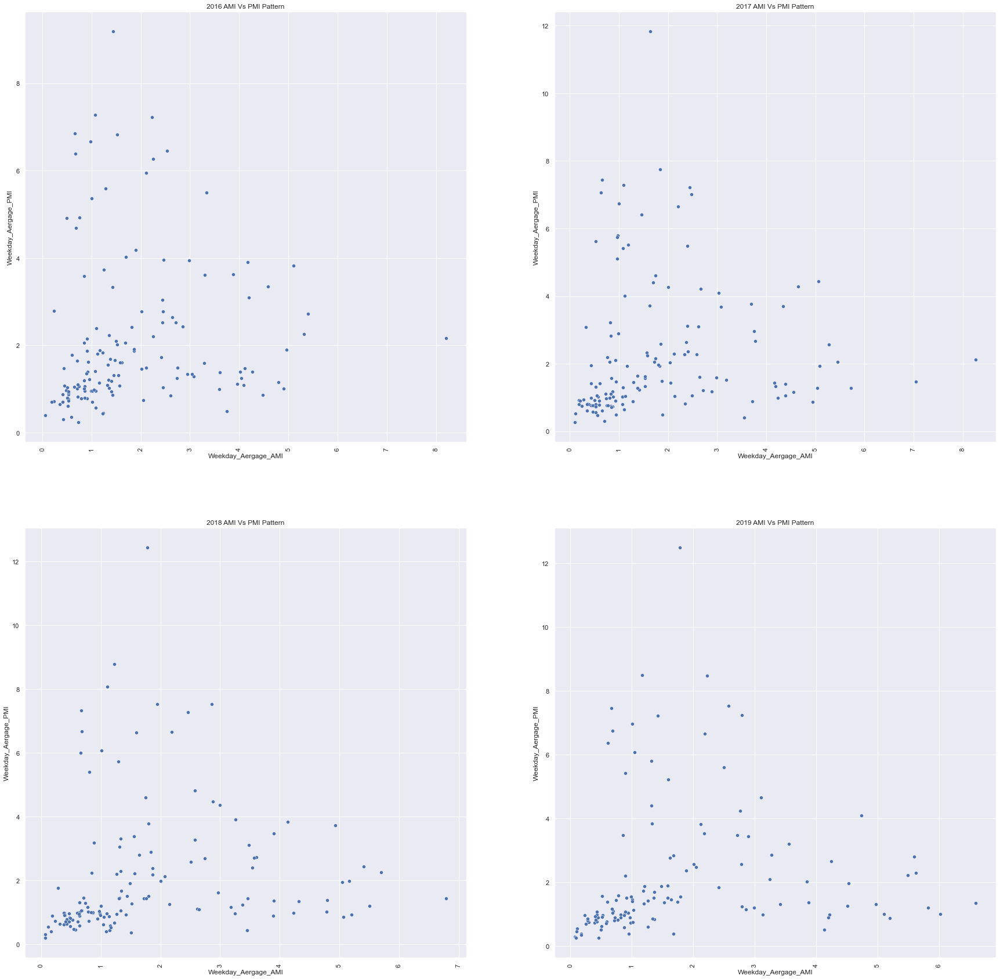

In [8]:
d16=ind.loc[ind['year']==2016]
d17=ind.loc[ind['year']==2017]
d18=ind.loc[ind['year']==2018]
d19=ind.loc[ind['year']==2019]
import seaborn as sns
sns.set(font_scale=2.0)
sns.set(rc={'figure.figsize':(30,30)})




fig, ax = plt.subplots(2,2)

ax1 = sns.scatterplot(x=d16['Weekday_Aergage_AMI'],y=d16['Weekday_Aergage_PMI'],
                   markers=True,marker="o", ax=ax[0,0]) 
plt.xticks(rotation = 'vertical')
ax2 = sns.scatterplot(x=d17['Weekday_Aergage_AMI'],y=d17['Weekday_Aergage_PMI'],
                   markers=True,marker="o", ax=ax[0,1]) 
plt.xticks(rotation = 'vertical')
ax3 = sns.scatterplot(x=d18['Weekday_Aergage_AMI'],y=d18['Weekday_Aergage_PMI'],
                   markers=True,marker="o",ax=ax[1,0])
plt.xticks(rotation = 'vertical')
ax4 = sns.scatterplot(x=d19['Weekday_Aergage_AMI'],y=d19['Weekday_Aergage_PMI'],
                   markers=True, marker="o",ax=ax[1,1]) 

ax1.title.set_text('2016 AMI Vs PMI Pattern')
ax2.title.set_text('2017 AMI Vs PMI Pattern')
ax3.title.set_text('2018 AMI Vs PMI Pattern')
ax4.title.set_text('2019 AMI Vs PMI Pattern')
plt.setp(ax1.xaxis.get_majorticklabels(), rotation=90)
plt.setp(ax2.xaxis.get_majorticklabels(), rotation=90)
plt.setp(ax3.xaxis.get_majorticklabels(), rotation=90)
plt.setp(ax4.xaxis.get_majorticklabels(), rotation=90)
ax1.set_ylabel('Weekday_Aergage_PMI' )
ax1.set_xlabel('Weekday_Aergage_AMI')
ax2.set_ylabel('Weekday_Aergage_PMI' )
ax2.set_xlabel('Weekday_Aergage_AMI')
ax3.set_ylabel('Weekday_Aergage_PMI' )
ax3.set_xlabel('Weekday_Aergage_AMI')
ax4.set_ylabel('Weekday_Aergage_PMI' )
ax4.set_xlabel('Weekday_Aergage_AMI')
plt.show()

In [9]:
# Separate Recreation Vs Commute Trip 
ind19=ind.loc[ind['year']==2019]
ind18=ind.loc[ind['year']==2018]
reccom=pd.concat([ind18,ind19],axis=0)
reccom.head()

,Unnamed: 0.1,ID,year,Max_WWI,Average_WWI,Weekday_Aergage_AMI,Weekend_Aergage_AMI,Average AMI_wday_wend,Max_weekend_AMI,Max_weekday_AMI,...,state,country,Unnamed: 0,edgeUID,osmId,stv_total,stv_com_total,stv_rec_total,stv_com_ratio,stv_rec_ratio
2,2,671,2018,1.35,0.71,0.86,0.29,2.97,0.30,1.43,...,California,United States,0,308723101,215845474,4890.00,260.00,4630.00,0.05,0.95
9,9,2694,2018,3.44,0.96,0.68,3.10,0.22,3.18,1.03,...,California,United States,5,306405706,59238912,26680.00,320.00,26360.00,0.01,0.99
17,17,2698,2018,12.50,1.30,1.80,1.60,1.13,1.67,2.73,...,California,United States,12,311886927,787298838,6740.00,65.00,6675.00,0.01,0.99
23,23,3560,2018,0.52,0.33,1.10,0.65,1.70,0.74,1.23,...,California,United States,14,306522865,98225976,4730.00,775.00,3955.00,0.16,0.84
27,27,3561,2018,1.36,0.76,0.55,0.57,0.95,0.67,0.60,...,California,United States,16,306448331,795421657,37085.00,1425.00,35660.00,0.04,0.96


In [10]:
def comm_pattern(stv_com_ratio,stv_rec_ratio):
    if (stv_com_ratio>=0.60 and stv_rec_ratio<0.40):
        return 'commute'
    elif (stv_rec_ratio>=0.60 and stv_com_ratio<0.40):
        return 'recreational'
    else:
        return 'mixed'
    

In [11]:
reccom['travel pattern']=reccom.apply(lambda row: comm_pattern(row['stv_com_ratio'],row['stv_rec_ratio']),axis=1)
reccom.head()

,Unnamed: 0.1,ID,year,Max_WWI,Average_WWI,Weekday_Aergage_AMI,Weekend_Aergage_AMI,Average AMI_wday_wend,Max_weekend_AMI,Max_weekday_AMI,...,country,Unnamed: 0,edgeUID,osmId,stv_total,stv_com_total,stv_rec_total,stv_com_ratio,stv_rec_ratio,travel pattern
2,2,671,2018,1.35,0.71,0.86,0.29,2.97,0.30,1.43,...,United States,0,308723101,215845474,4890.00,260.00,4630.00,0.05,0.95,recreational
9,9,2694,2018,3.44,0.96,0.68,3.10,0.22,3.18,1.03,...,United States,5,306405706,59238912,26680.00,320.00,26360.00,0.01,0.99,recreational
17,17,2698,2018,12.50,1.30,1.80,1.60,1.13,1.67,2.73,...,United States,12,311886927,787298838,6740.00,65.00,6675.00,0.01,0.99,recreational
23,23,3560,2018,0.52,0.33,1.10,0.65,1.70,0.74,1.23,...,United States,14,306522865,98225976,4730.00,775.00,3955.00,0.16,0.84,recreational
27,27,3561,2018,1.36,0.76,0.55,0.57,0.95,0.67,0.60,...,United States,16,306448331,795421657,37085.00,1425.00,35660.00,0.04,0.96,recreational


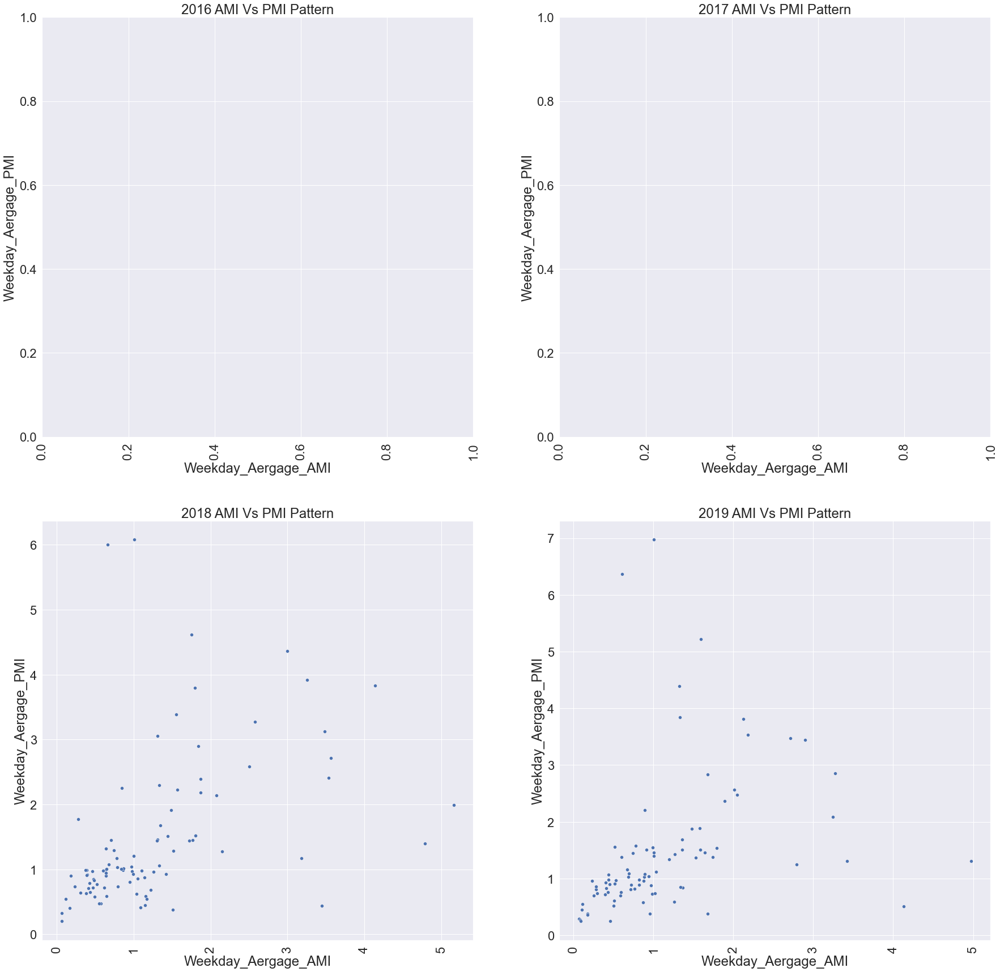

In [12]:
rec=reccom.loc[reccom['travel pattern']=='recreational']
d16=rec.loc[rec['year']==2016]
d17=rec.loc[rec['year']==2017]
d18=rec.loc[rec['year']==2018]
d19=rec.loc[rec['year']==2019]

sns.set(rc={'figure.figsize':(30,30)})
sns.set(font_scale=2.0)
import seaborn as sns


fig, ax = plt.subplots(2,2)

ax1 = sns.scatterplot(x=d16['Weekday_Aergage_AMI'],y=d16['Weekday_Aergage_PMI'],
                   markers=True,marker="o", ax=ax[0,0]) 
plt.xticks(rotation = 'vertical')
ax2 = sns.scatterplot(x=d17['Weekday_Aergage_AMI'],y=d17['Weekday_Aergage_PMI'],
                   markers=True,marker="o", ax=ax[0,1]) 
plt.xticks(rotation = 'vertical')
ax3 = sns.scatterplot(x=d18['Weekday_Aergage_AMI'],y=d18['Weekday_Aergage_PMI'],
                   markers=True,marker="o",ax=ax[1,0])
plt.xticks(rotation = 'vertical')
ax4 = sns.scatterplot(x=d19['Weekday_Aergage_AMI'],y=d19['Weekday_Aergage_PMI'],
                   markers=True, marker="o",ax=ax[1,1]) 

ax1.title.set_text('2016 AMI Vs PMI Pattern')
ax2.title.set_text('2017 AMI Vs PMI Pattern')
ax3.title.set_text('2018 AMI Vs PMI Pattern')
ax4.title.set_text('2019 AMI Vs PMI Pattern')
plt.setp(ax1.xaxis.get_majorticklabels(), rotation=90)
plt.setp(ax2.xaxis.get_majorticklabels(), rotation=90)
plt.setp(ax3.xaxis.get_majorticklabels(), rotation=90)
plt.setp(ax4.xaxis.get_majorticklabels(), rotation=90)
ax1.set_ylabel('Weekday_Aergage_PMI' )
ax1.set_xlabel('Weekday_Aergage_AMI')
ax2.set_ylabel('Weekday_Aergage_PMI' )
ax2.set_xlabel('Weekday_Aergage_AMI')
ax3.set_ylabel('Weekday_Aergage_PMI' )
ax3.set_xlabel('Weekday_Aergage_AMI')
ax4.set_ylabel('Weekday_Aergage_PMI' )
ax4.set_xlabel('Weekday_Aergage_AMI')
plt.show()

## Recreational,Commute and Mixed based on Strava Recreational and Commute Ratio

## for the weekday

In [13]:
# check the HOD factor by Recreation and commute type trip
weekday=pd.merge(doh_weekday_factor,reccom, left_on=['ID','year'], right_on=['ID','year'], how='inner')
weekday.head(15)

,Unnamed: 0_x,ID,year,starttime,Average_HOD,sum of Average_HOD,HOD,Unnamed: 0.1,Max_WWI,Average_WWI,...,country,Unnamed: 0_y,edgeUID,osmId,stv_total,stv_com_total,stv_rec_total,stv_com_ratio,stv_rec_ratio,travel pattern
0,48,671,2018,00:00:00,0.04,44.70,0.00,2,1.35,0.71,...,United States,0,308723101,215845474,4890.00,260.00,4630.00,0.05,0.95,recreational
1,49,671,2018,01:00:00,0.06,44.70,0.00,2,1.35,0.71,...,United States,0,308723101,215845474,4890.00,260.00,4630.00,0.05,0.95,recreational
2,50,671,2018,02:00:00,0.00,44.70,0.00,2,1.35,0.71,...,United States,0,308723101,215845474,4890.00,260.00,4630.00,0.05,0.95,recreational
3,51,671,2018,03:00:00,0.01,44.70,0.00,2,1.35,0.71,...,United States,0,308723101,215845474,4890.00,260.00,4630.00,0.05,0.95,recreational
4,52,671,2018,04:00:00,0.02,44.70,0.00,2,1.35,0.71,...,United States,0,308723101,215845474,4890.00,260.00,4630.00,0.05,0.95,recreational
5,53,671,2018,05:00:00,0.18,44.70,0.00,2,1.35,0.71,...,United States,0,308723101,215845474,4890.00,260.00,4630.00,0.05,0.95,recreational
6,54,671,2018,06:00:00,1.21,44.70,0.03,2,1.35,0.71,...,United States,0,308723101,215845474,4890.00,260.00,4630.00,0.05,0.95,recreational
7,55,671,2018,07:00:00,1.96,44.70,0.04,2,1.35,0.71,...,United States,0,308723101,215845474,4890.00,260.00,4630.00,0.05,0.95,recreational
8,56,671,2018,08:00:00,3.49,44.70,0.08,2,1.35,0.71,...,United States,0,308723101,215845474,4890.00,260.00,4630.00,0.05,0.95,recreational
9,57,671,2018,09:00:00,5.75,44.70,0.13,2,1.35,0.71,...,United States,0,308723101,215845474,4890.00,260.00,4630.00,0.05,0.95,recreational


In [14]:
def multiplot(rec1):
    d18=rec1.loc[rec1['year']==2018]
    d19=rec1.loc[rec1['year']==2019]
    import seaborn as sns

    sns.set(rc={'figure.figsize':(30,15)})
    sns.set(font_scale=2.0)
   


    fig, ax = plt.subplots(1,2)

    ax1 = sns.lineplot(x=d18['starttime'],y=d18['HOD'],hue=d18['ID'],
                       markers=True,marker="o", dashes=False,sort=True,ax=ax[0])
    plt.xticks(rotation = 'vertical')
    ax1.tick_params(axis='x', rotation=90)
    ax2 = sns.lineplot(x=d19['starttime'],y=d19['HOD'],hue=d19['ID'],
                       markers=True, marker="o", dashes=False,sort=True,ax=ax[1]) 
    plt.xticks(rotation = 'vertical')
    ax1.get_legend().remove()
    ax2.get_legend().remove()
    ax1.title.set_text('2018 Weekday Recreational HOD Factor')
    ax2.title.set_text('2019 Weekday Recreational HOD  Factor')
    plt.setp(ax3.xaxis.get_majorticklabels(), rotation=90)
    plt.setp(ax4.xaxis.get_majorticklabels(), rotation=90)
    ax1.set_ylabel('Weekday HOD Factor' )
    ax1.set_xlabel('Time')
    ax2.set_ylabel('Weekday HOD Factor' )
    ax2.set_xlabel('Time')
    plt.show()


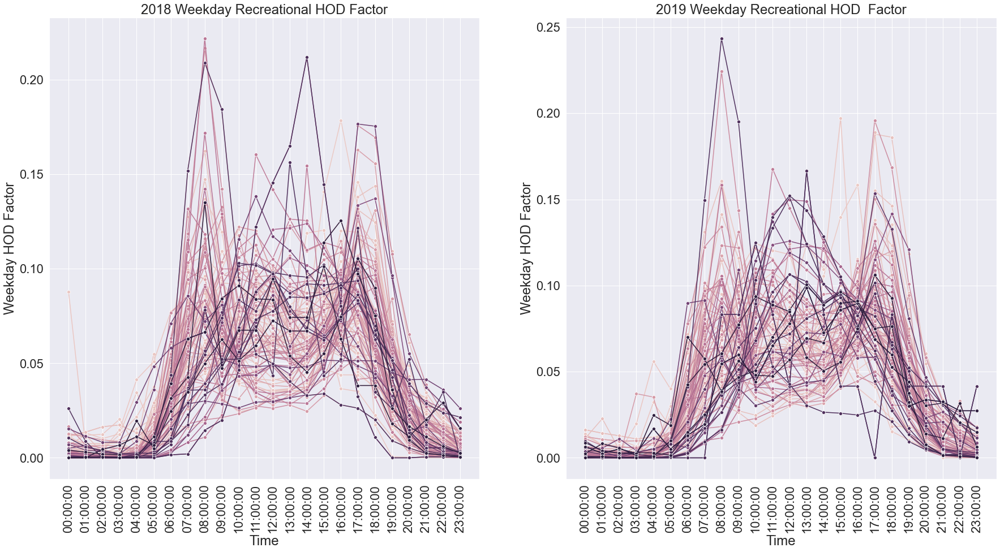

In [15]:
rec1=weekday.loc[weekday['travel pattern']=='recreational']
multiplot(rec1)

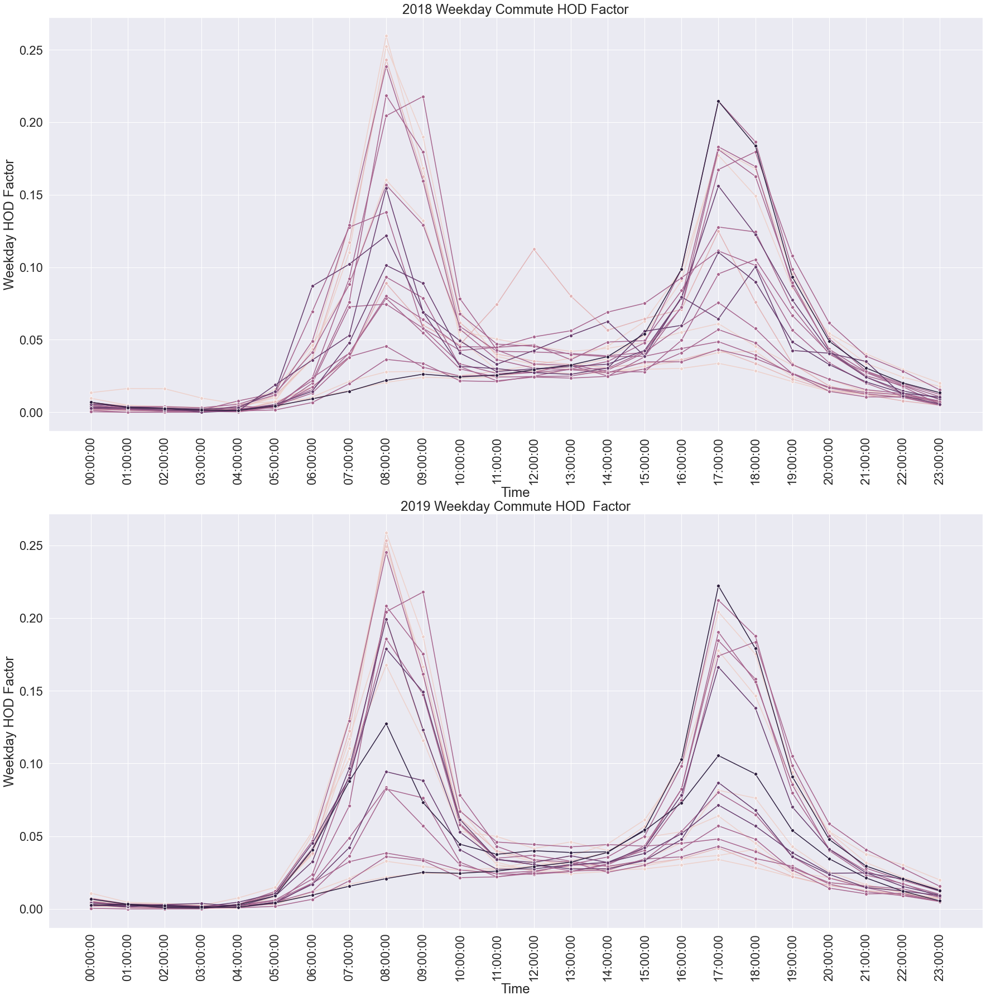

In [16]:
rec1=weekday.loc[weekday['travel pattern']=='commute']
d18=rec1.loc[rec1['year']==2018]
d19=rec1.loc[rec1['year']==2019]

sns.set(rc={'figure.figsize':(30,30)})
sns.set(font_scale=2.0)
import seaborn as sns


fig, ax = plt.subplots(2,1)
plt.xticks(rotation = 'vertical')
ax1 = sns.lineplot(x=d18['starttime'],y=d18['HOD'],hue=d18['ID'],
                   markers=True,marker="o", dashes=False,sort=True,ax=ax[0])
plt.xticks(rotation = 'vertical')
ax1.tick_params(axis='x', rotation=90)
ax2 = sns.lineplot(x=d19['starttime'],y=d19['HOD'],hue=d19['ID'],
                   markers=True, marker="o", dashes=False,sort=True,ax=ax[1]) 
plt.xticks(rotation = 'vertical')
ax1.get_legend().remove()
ax2.get_legend().remove()
ax1.title.set_text('2018 Weekday Commute HOD Factor')
ax2.title.set_text('2019 Weekday Commute HOD  Factor')
plt.setp(ax3.xaxis.get_majorticklabels(), rotation=90)
plt.setp(ax4.xaxis.get_majorticklabels(), rotation=90)
ax1.set_ylabel('Weekday HOD Factor' )
ax1.set_xlabel('Time')
ax2.set_ylabel('Weekday HOD Factor' )
ax2.set_xlabel('Time')
plt.show()

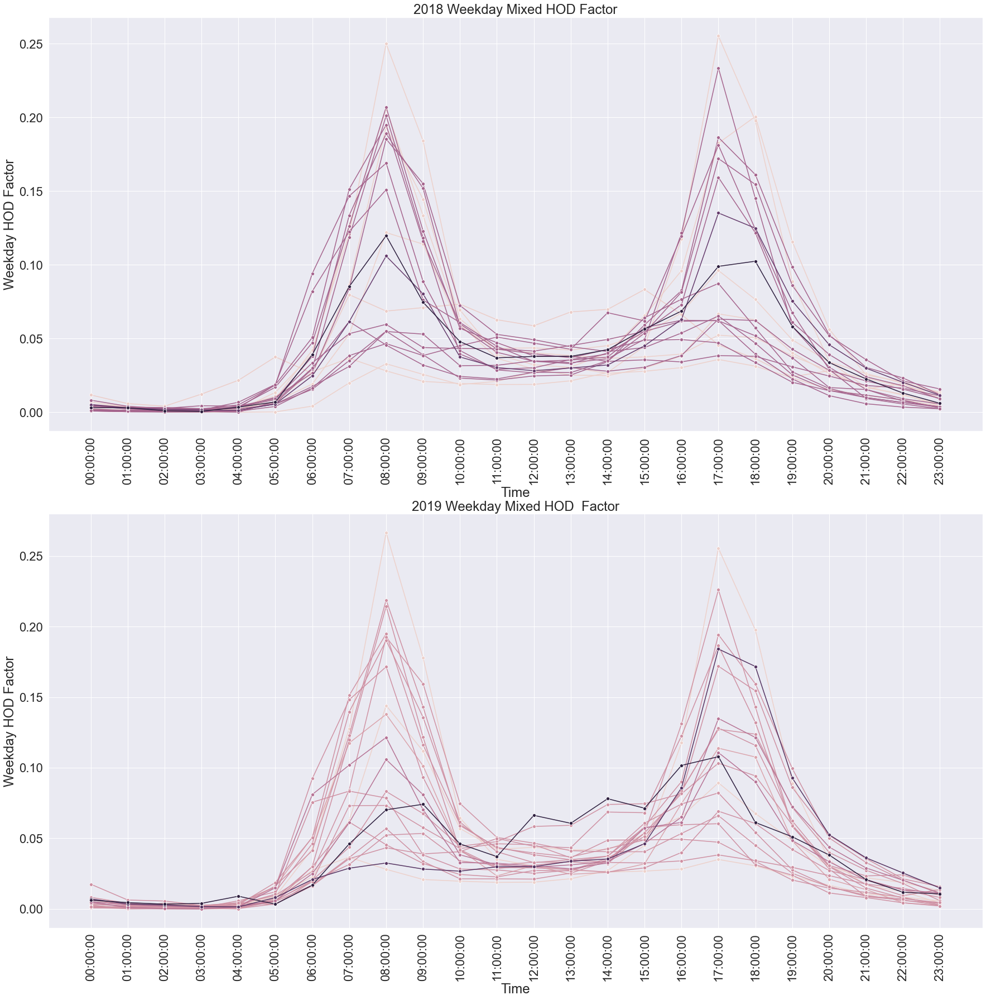

In [17]:
rec1=weekday.loc[weekday['travel pattern']=='mixed']
d18=rec1.loc[rec1['year']==2018]
d19=rec1.loc[rec1['year']==2019]

sns.set(rc={'figure.figsize':(30,30)})
sns.set(font_scale=2.0)
import seaborn as sns


fig, ax = plt.subplots(2,1)

ax1 = sns.lineplot(x=d18['starttime'],y=d18['HOD'],hue=d18['ID'],
                   markers=True,marker="o", dashes=False,sort=True,ax=ax[0])
plt.xticks(rotation = 'vertical')
ax1.tick_params(axis='x', rotation=90)
ax2 = sns.lineplot(x=d19['starttime'],y=d19['HOD'],hue=d19['ID'],
                   markers=True, marker="o", dashes=False,sort=True,ax=ax[1]) 
plt.xticks(rotation = 'vertical')
ax1.get_legend().remove()
ax2.get_legend().remove()
ax1.title.set_text('2018 Weekday Mixed HOD Factor')
ax2.title.set_text('2019 Weekday Mixed HOD  Factor')
plt.setp(ax3.xaxis.get_majorticklabels(), rotation=90)
plt.setp(ax4.xaxis.get_majorticklabels(), rotation=90)
ax1.set_ylabel('Weekday HOD Factor' )
ax1.set_xlabel('Time')
ax2.set_ylabel('Weekday HOD Factor' )
ax2.set_xlabel('Time')
plt.show()

# check for the weekend pattern

In [18]:
# check the HOD factor by Recreation and commute type trip
weekend=pd.merge(doh_weekend_factor,reccom, left_on=['ID','year'], right_on=['ID','year'], how='inner')
weekend.head(15)

,Unnamed: 0_x,ID,year,starttime,Average_HOD,sum of Average_HOD,HOD,Unnamed: 0.1,Max_WWI,Average_WWI,...,country,Unnamed: 0_y,edgeUID,osmId,stv_total,stv_com_total,stv_rec_total,stv_com_ratio,stv_rec_ratio,travel pattern
0,48,671,2018,00:00:00,0.04,76.21,0.00,2,1.35,0.71,...,United States,0,308723101,215845474,4890.00,260.00,4630.00,0.05,0.95,recreational
1,49,671,2018,01:00:00,0.04,76.21,0.00,2,1.35,0.71,...,United States,0,308723101,215845474,4890.00,260.00,4630.00,0.05,0.95,recreational
2,50,671,2018,02:00:00,0.02,76.21,0.00,2,1.35,0.71,...,United States,0,308723101,215845474,4890.00,260.00,4630.00,0.05,0.95,recreational
3,51,671,2018,03:00:00,0.03,76.21,0.00,2,1.35,0.71,...,United States,0,308723101,215845474,4890.00,260.00,4630.00,0.05,0.95,recreational
4,52,671,2018,04:00:00,0.02,76.21,0.00,2,1.35,0.71,...,United States,0,308723101,215845474,4890.00,260.00,4630.00,0.05,0.95,recreational
5,53,671,2018,05:00:00,0.26,76.21,0.00,2,1.35,0.71,...,United States,0,308723101,215845474,4890.00,260.00,4630.00,0.05,0.95,recreational
6,54,671,2018,06:00:00,0.48,76.21,0.01,2,1.35,0.71,...,United States,0,308723101,215845474,4890.00,260.00,4630.00,0.05,0.95,recreational
7,55,671,2018,07:00:00,1.69,76.21,0.02,2,1.35,0.71,...,United States,0,308723101,215845474,4890.00,260.00,4630.00,0.05,0.95,recreational
8,56,671,2018,08:00:00,3.46,76.21,0.05,2,1.35,0.71,...,United States,0,308723101,215845474,4890.00,260.00,4630.00,0.05,0.95,recreational
9,57,671,2018,09:00:00,7.53,76.21,0.10,2,1.35,0.71,...,United States,0,308723101,215845474,4890.00,260.00,4630.00,0.05,0.95,recreational


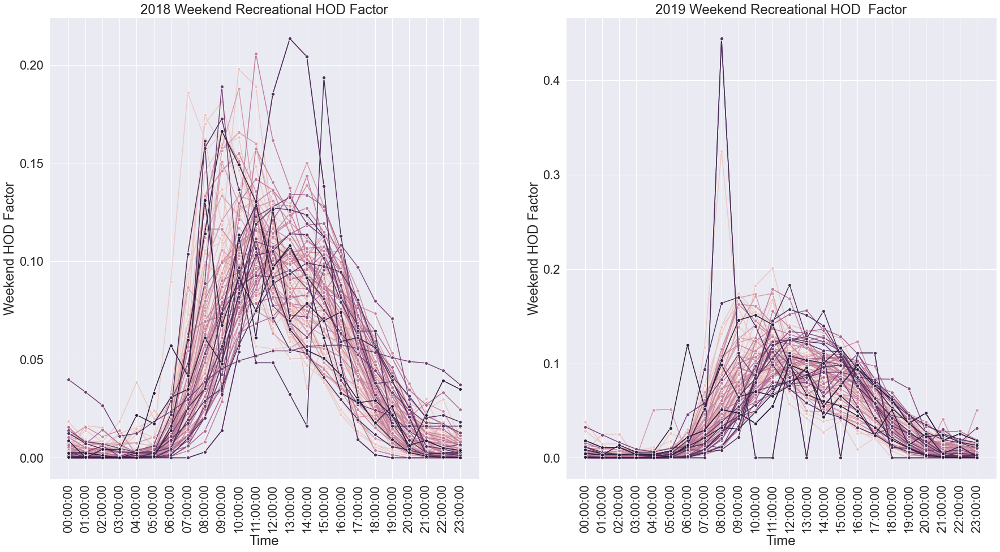

In [19]:
com1=weekend.loc[weekend['travel pattern']=='recreational']
d18=com1.loc[com1['year']==2018]
d19=com1.loc[com1['year']==2019]
import seaborn as sns

sns.set(rc={'figure.figsize':(30,15)})
sns.set(font_scale=2.0)



fig, ax = plt.subplots(1,2)

ax1 = sns.lineplot(x=d18['starttime'],y=d18['HOD'],hue=d18['ID'],
                   markers=True,marker="o", dashes=False,sort=True,ax=ax[0])
plt.xticks(rotation = 'vertical')
ax1.tick_params(axis='x', rotation=90)
ax2 = sns.lineplot(x=d19['starttime'],y=d19['HOD'],hue=d19['ID'],
                   markers=True, marker="o", dashes=False,sort=True,ax=ax[1]) 
plt.xticks(rotation = 'vertical')
ax1.get_legend().remove()
ax2.get_legend().remove()
ax1.title.set_text('2018 Weekend Recreational HOD Factor')
ax2.title.set_text('2019 Weekend Recreational HOD  Factor')
plt.setp(ax3.xaxis.get_majorticklabels(), rotation=90)
plt.setp(ax4.xaxis.get_majorticklabels(), rotation=90)
ax1.set_ylabel('Weekend HOD Factor' )
ax1.set_xlabel('Time')
ax2.set_ylabel('Weekend HOD Factor' )
ax2.set_xlabel('Time')
plt.show()


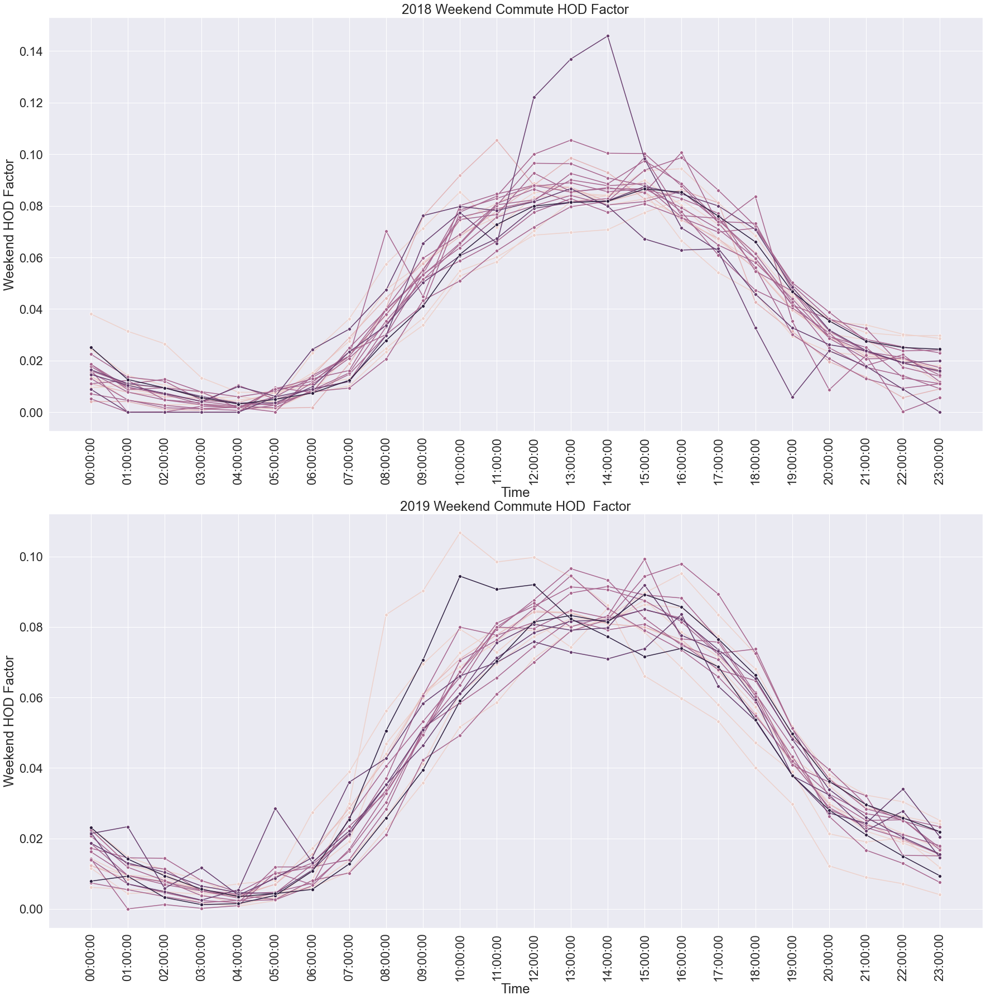

In [20]:
com1=weekend.loc[weekend['travel pattern']=='commute']
d18=com1.loc[com1['year']==2018]
d19=com1.loc[com1['year']==2019]

sns.set(rc={'figure.figsize':(30,30)})
sns.set(font_scale=2.0)
import seaborn as sns


fig, ax = plt.subplots(2,1)
plt.xticks(rotation = 'vertical')
ax1 = sns.lineplot(x=d18['starttime'],y=d18['HOD'],hue=d18['ID'],
                   markers=True,marker="o", dashes=False,sort=True,ax=ax[0])
plt.xticks(rotation = 'vertical')
ax1.tick_params(axis='x', rotation=90)
ax2 = sns.lineplot(x=d19['starttime'],y=d19['HOD'],hue=d19['ID'],
                   markers=True, marker="o", dashes=False,sort=True,ax=ax[1]) 
plt.xticks(rotation = 'vertical')
ax1.get_legend().remove()
ax2.get_legend().remove()
ax1.title.set_text('2018 Weekend Commute HOD Factor')
ax2.title.set_text('2019 Weekend Commute HOD  Factor')
plt.setp(ax3.xaxis.get_majorticklabels(), rotation=90)
plt.setp(ax4.xaxis.get_majorticklabels(), rotation=90)
ax1.set_ylabel('Weekend HOD Factor' )
ax1.set_xlabel('Time')
ax2.set_ylabel('Weekend HOD Factor' )
ax2.set_xlabel('Time')
plt.show()

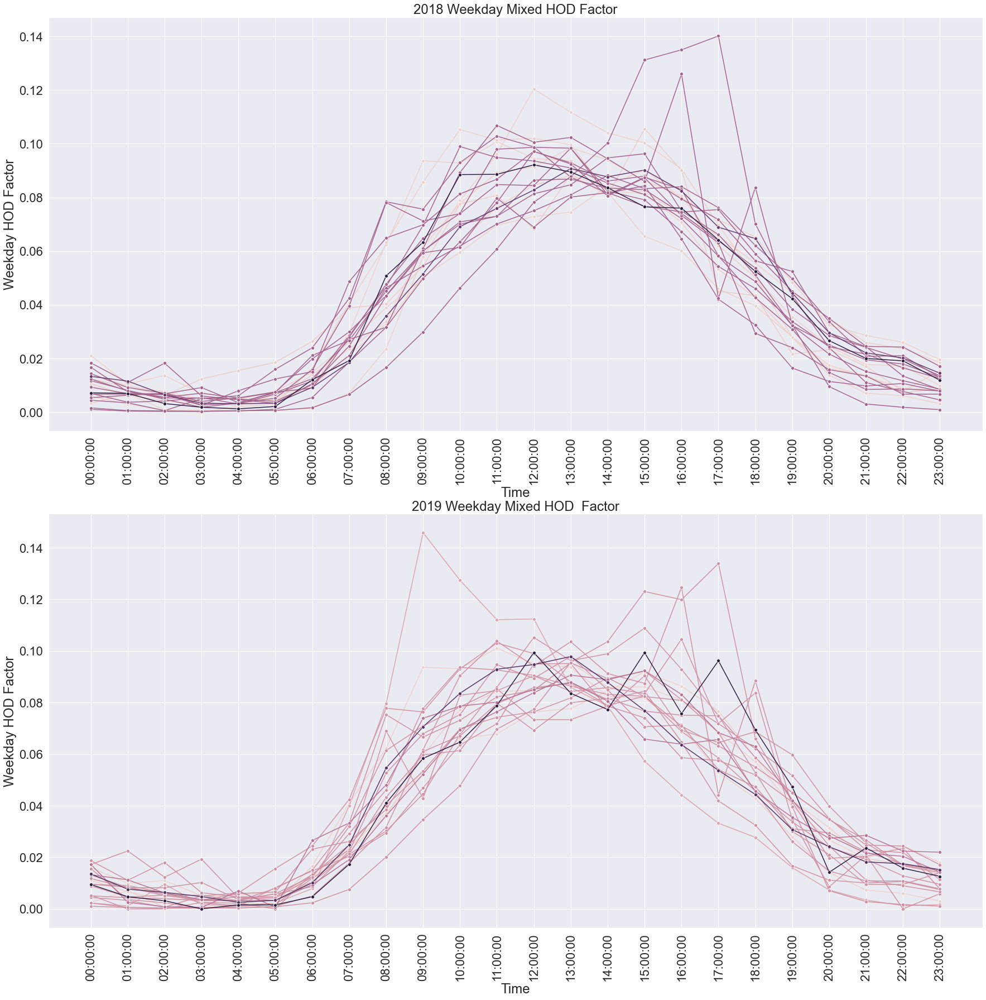

In [21]:
com1=weekend.loc[weekend['travel pattern']=='mixed']
d18=com1.loc[com1['year']==2018]
d19=com1.loc[com1['year']==2019]

sns.set(rc={'figure.figsize':(30,30)})
sns.set(font_scale=2.0)
import seaborn as sns


fig, ax = plt.subplots(2,1)

ax1 = sns.lineplot(x=d18['starttime'],y=d18['HOD'],hue=d18['ID'],
                   markers=True,marker="o", dashes=False,sort=True,ax=ax[0])
plt.xticks(rotation = 'vertical')
ax1.tick_params(axis='x', rotation=90)
ax2 = sns.lineplot(x=d19['starttime'],y=d19['HOD'],hue=d19['ID'],
                   markers=True, marker="o", dashes=False,sort=True,ax=ax[1]) 
plt.xticks(rotation = 'vertical')
ax1.get_legend().remove()
ax2.get_legend().remove()
ax1.title.set_text('2018 Weekday Mixed HOD Factor')
ax2.title.set_text('2019 Weekday Mixed HOD  Factor')
plt.setp(ax3.xaxis.get_majorticklabels(), rotation=90)
plt.setp(ax4.xaxis.get_majorticklabels(), rotation=90)
ax1.set_ylabel('Weekday HOD Factor' )
ax1.set_xlabel('Time')
ax2.set_ylabel('Weekday HOD Factor' )
ax2.set_xlabel('Time')
plt.show()

In [22]:
weekday.columns

Index(['Unnamed: 0_x', 'ID', 'year', 'starttime', 'Average_HOD',
       'sum of Average_HOD', 'HOD', 'Unnamed: 0.1', 'Max_WWI', 'Average_WWI',
       'Weekday_Aergage_AMI', 'Weekend_Aergage_AMI', 'Average AMI_wday_wend',
       'Max_weekend_AMI', 'Max_weekday_AMI', 'Daily_Max_AMI', 'Daily_Max_PMI',
       'Weekday_Aergage_PMI', 'Weekend_Aergage_PMI', 'Average PMI_wday_wend',
       'Max_weekday_PMI', 'Max_weekend_PMI', 'max_daily_am_pm',
       'max_daily_am/pm_value', 'max_weekend_am/pm', 'max_weekend_am_pm_Value',
       'max_weekday_am/pm', 'max_weekday_am_pm_value', 'seasonal_factor',
       'latitude', 'longitude', 'location', 'road', 'city', 'county', 'state',
       'country', 'Unnamed: 0_y', 'edgeUID', 'osmId', 'stv_total',
       'stv_com_total', 'stv_rec_total', 'stv_com_ratio', 'stv_rec_ratio',
       'travel pattern'],
      dtype='object')

# Check the Seasonality Pattern for Weekday

In [23]:
# join indices and weekday HOD factor together
seasional_weekday=pd.merge(doh_weekday_factor,ind, left_on=['ID','year'], right_on=['ID','year'], how='inner')
seasional_weekday.shape

(14280, 45)

In [24]:
#define Function for plot
def multiplot4(seasional_weekday):
    d16=seasional_weekday.loc[seasional_weekday['year']==2016]
    d17=seasional_weekday.loc[seasional_weekday['year']==2017]
    d18=seasional_weekday.loc[seasional_weekday['year']==2018]
    d19=seasional_weekday.loc[seasional_weekday['year']==2019]
    import seaborn as sns

    sns.set(rc={'figure.figsize':(30,30)})
    sns.set(font_scale=2.0)
   


    fig, ax = plt.subplots(2,2)

    ax1 = sns.lineplot(x=d16['starttime'],y=d16['HOD'],hue=d16['ID'],
                       markers=True,marker="o", dashes=False,sort=True,ax=ax[0,0]) 
    plt.xticks(rotation = 'vertical')
    ax2 = sns.lineplot(x=d17['starttime'],y=d17['HOD'],hue=d17['ID'],
                       markers=True,marker="o", dashes=False,sort=True,ax=ax[0,1]) 
    plt.xticks(rotation = 'vertical')
    ax3 = sns.lineplot(x=d18['starttime'],y=d18['HOD'],hue=d18['ID'],
                       markers=True,marker="o", dashes=False,sort=True,ax=ax[1,0])
    plt.xticks(rotation = 'vertical')
    ax4 = sns.lineplot(x=d19['starttime'],y=d19['HOD'],hue=d19['ID'],
                       markers=True, marker="o", dashes=False,sort=True,ax=ax[1,1]) 
    plt.xticks(rotation = 'vertical')
    ax1.get_legend().remove()
    ax2.get_legend().remove()
    ax3.get_legend().remove()
    ax4.get_legend().remove()
    ax1.title.set_text('2016 Weekday HOD Factor')
    ax2.title.set_text('2017 Weekday HOD  Factor')
    ax3.title.set_text('2018 Weekday HOD Factor')
    ax4.title.set_text('2019 Weekday HOD  Factor')
    plt.setp(ax1.xaxis.get_majorticklabels(), rotation=90)
    plt.setp(ax2.xaxis.get_majorticklabels(), rotation=90)
    plt.setp(ax3.xaxis.get_majorticklabels(), rotation=90)
    plt.setp(ax4.xaxis.get_majorticklabels(), rotation=90)
    ax1.set_ylabel('Weekday HOD Factor' )
    ax1.set_xlabel('Time')
    ax2.set_ylabel('Weekday HOD Factor' )
    ax2.set_xlabel('Time')
    ax3.set_ylabel('Weekday HOD Factor' )
    ax3.set_xlabel('Time')
    ax4.set_ylabel('Weekday HOD Factor' )
    ax4.set_xlabel('Time')
    plt.show()


In [25]:
#classify the seasonal pattern
high_s1=seasional_weekday.loc[seasional_weekday['seasonal_factor']>2.0]
mid_s1 = seasional_weekday[(seasional_weekday.seasonal_factor>1) & (seasional_weekday.seasonal_factor<=1.5)]
mid_s2 = seasional_weekday[(seasional_weekday.seasonal_factor>1.5) & (seasional_weekday.seasonal_factor<=2)]
low_s1 = seasional_weekday.loc[seasional_weekday['seasonal_factor']<=1.0]
high_s1.shape,mid_s1.shape,low_s1.shape

((1656, 45), (6840, 45), (792, 45))

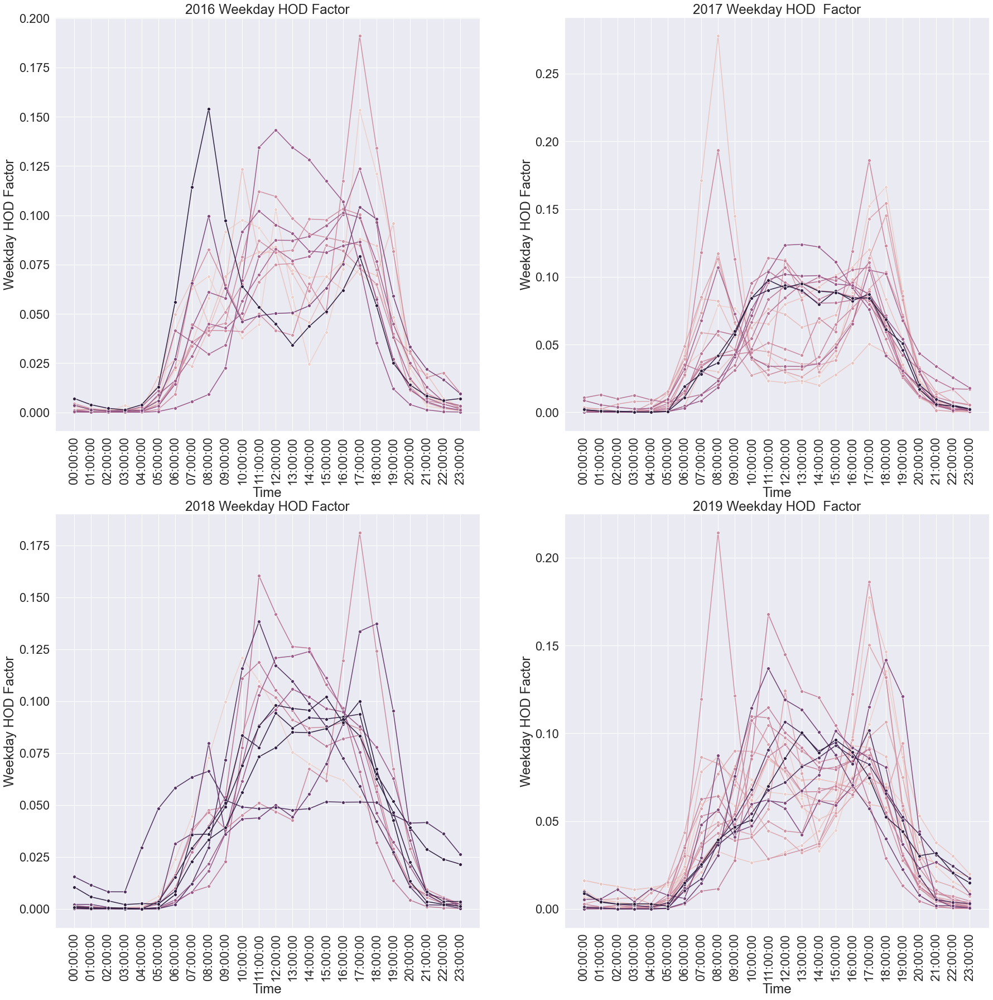

In [26]:
multiplot4(high_s1)

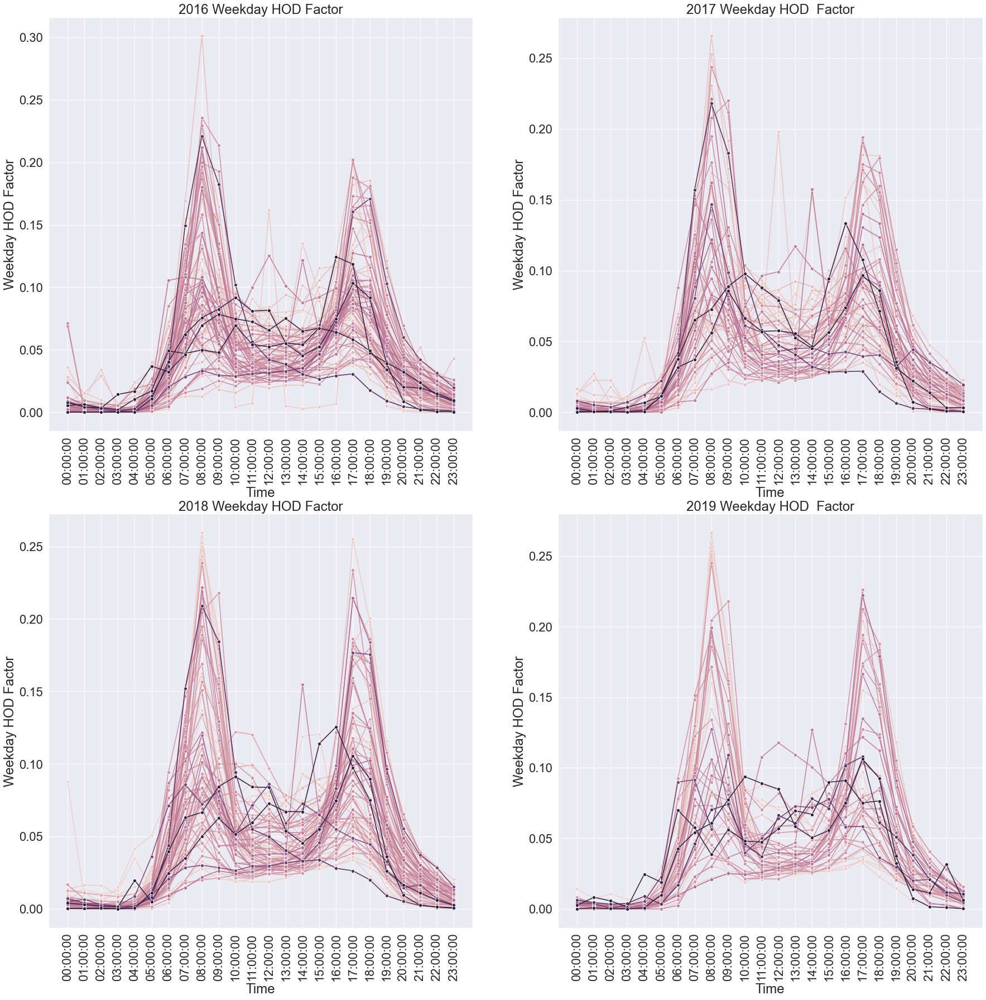

In [27]:
multiplot4(mid_s1)

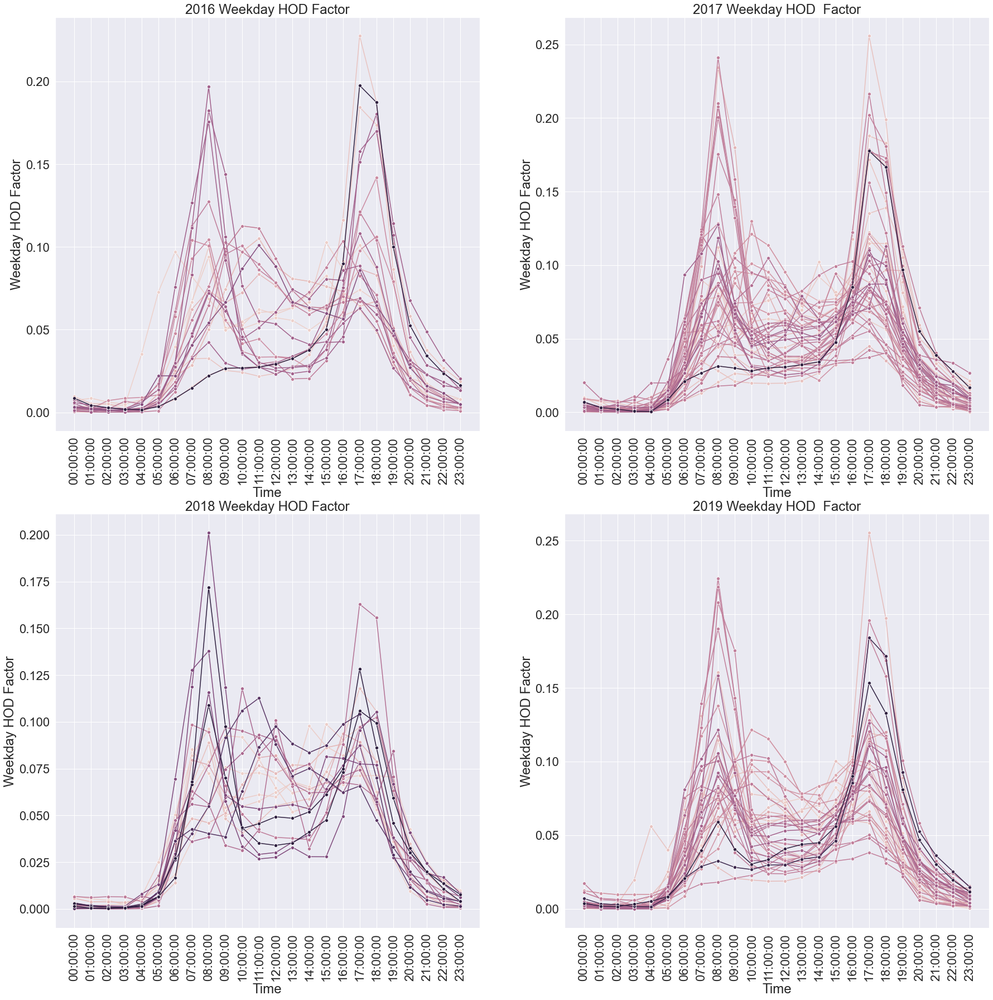

In [28]:
multiplot4(mid_s2)

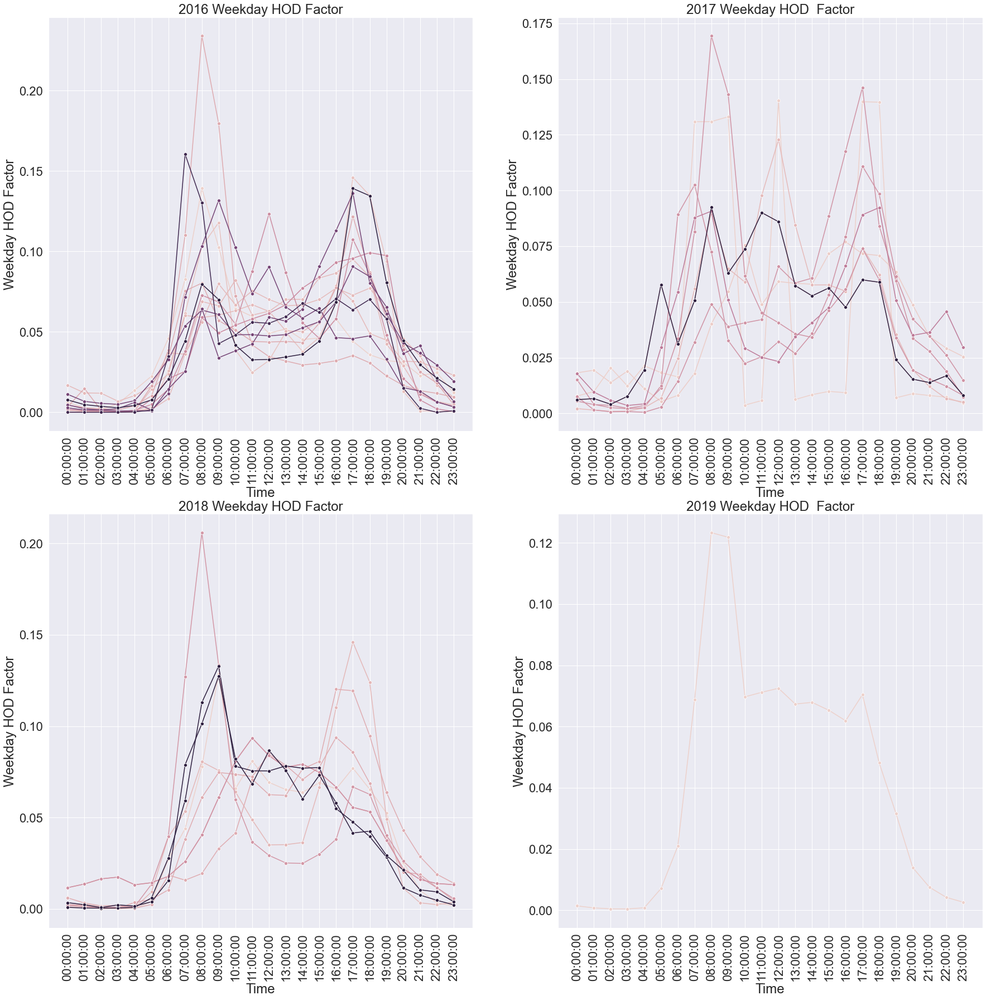

In [29]:
multiplot4(low_s1)

## Plot for Weekend Seasonal Factor Pattern

In [30]:
# join ind with weekend HOD factor
seasional_weekend=pd.merge(doh_weekend_factor,ind, left_on=['ID','year'], right_on=['ID','year'], how='inner')
seasional_weekend.shape

(14280, 45)

In [31]:
# define plot function
def multiplot4_weekend(seasional_weekend):
    d16=seasional_weekend.loc[seasional_weekend['year']==2016]
    d17=seasional_weekend.loc[seasional_weekend['year']==2017]
    d18=seasional_weekend.loc[seasional_weekend['year']==2018]
    d19=seasional_weekend.loc[seasional_weekend['year']==2019]
    import seaborn as sns

    sns.set(rc={'figure.figsize':(30,30)})
    sns.set(font_scale=2.0)
   


    fig, ax = plt.subplots(2,2)

    ax1 = sns.lineplot(x=d16['starttime'],y=d16['HOD'],hue=d16['ID'],
                       markers=True,marker="o", dashes=False,sort=True,ax=ax[0,0]) 
    plt.xticks(rotation = 'vertical')
    ax2 = sns.lineplot(x=d17['starttime'],y=d17['HOD'],hue=d17['ID'],
                       markers=True,marker="o", dashes=False,sort=True,ax=ax[0,1]) 
    plt.xticks(rotation = 'vertical')
    ax3 = sns.lineplot(x=d18['starttime'],y=d18['HOD'],hue=d18['ID'],
                       markers=True,marker="o", dashes=False,sort=True,ax=ax[1,0])
    plt.xticks(rotation = 'vertical')
    ax4 = sns.lineplot(x=d19['starttime'],y=d19['HOD'],hue=d19['ID'],
                       markers=True, marker="o", dashes=False,sort=True,ax=ax[1,1]) 
    plt.xticks(rotation = 'vertical')
    ax1.get_legend().remove()
    ax2.get_legend().remove()
    ax3.get_legend().remove()
    ax4.get_legend().remove()
    ax1.title.set_text('2016 Weekend HOD Factor')
    ax2.title.set_text('2017 Weekend HOD  Factor')
    ax3.title.set_text('2018 Weekend HOD Factor')
    ax4.title.set_text('2019 Weekend HOD  Factor')
    plt.setp(ax1.xaxis.get_majorticklabels(), rotation=90)
    plt.setp(ax2.xaxis.get_majorticklabels(), rotation=90)
    plt.setp(ax3.xaxis.get_majorticklabels(), rotation=90)
    plt.setp(ax4.xaxis.get_majorticklabels(), rotation=90)
    ax1.set_ylabel('Weekend HOD Factor' )
    ax1.set_xlabel('Time')
    ax2.set_ylabel('Weekend HOD Factor' )
    ax2.set_xlabel('Time')
    ax3.set_ylabel('Weekend HOD Factor' )
    ax3.set_xlabel('Time')
    ax4.set_ylabel('Weekend HOD Factor' )
    ax4.set_xlabel('Time')
    plt.show()


In [32]:
# classify the seasonality for weekend
high_s1w=seasional_weekend.loc[seasional_weekend['seasonal_factor']>2.0]
mid_s1w1 = seasional_weekend[(seasional_weekend.seasonal_factor>1) & (seasional_weekend.seasonal_factor<=1.5)]
mid_s1w2 = seasional_weekend[(seasional_weekend.seasonal_factor>1.5) & (seasional_weekend.seasonal_factor<=2)]
low_s1w = seasional_weekend.loc[seasional_weekend['seasonal_factor']<=1.0]


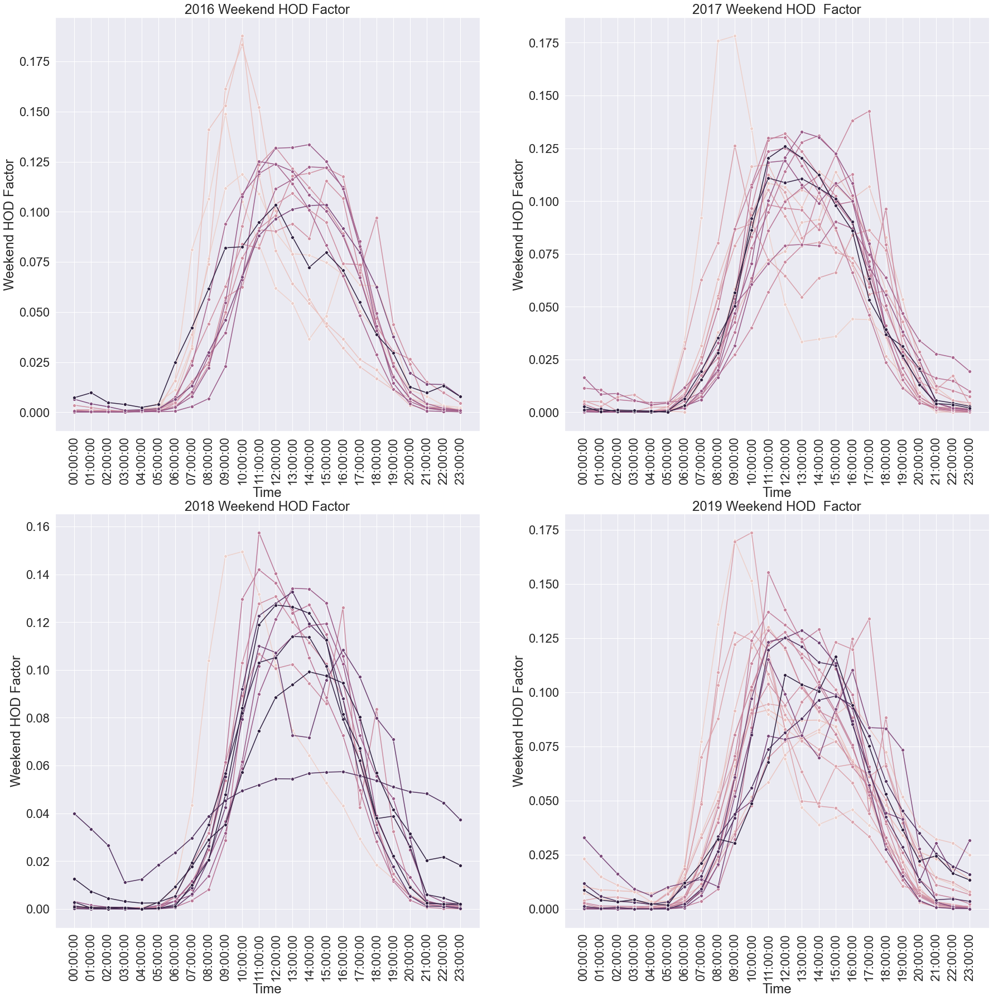

In [33]:
multiplot4_weekend(high_s1w)

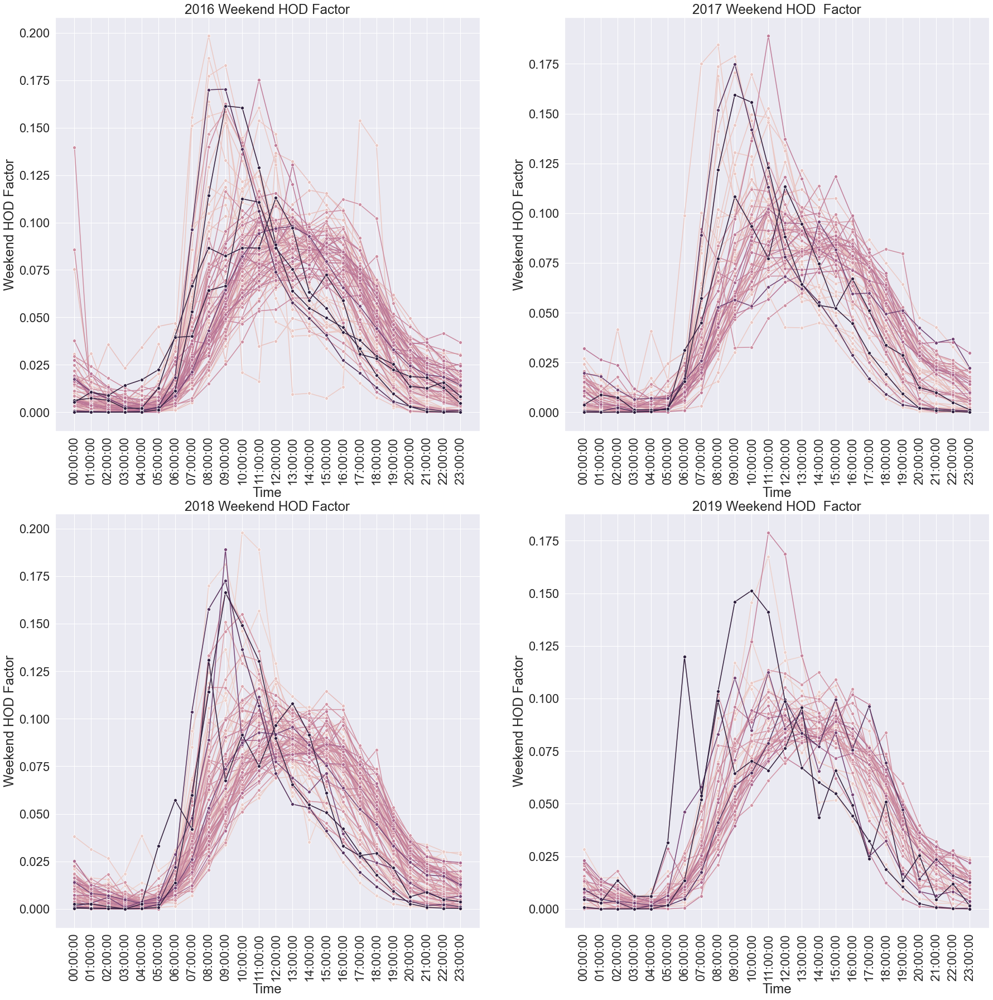

In [34]:
multiplot4_weekend(mid_s1w1)

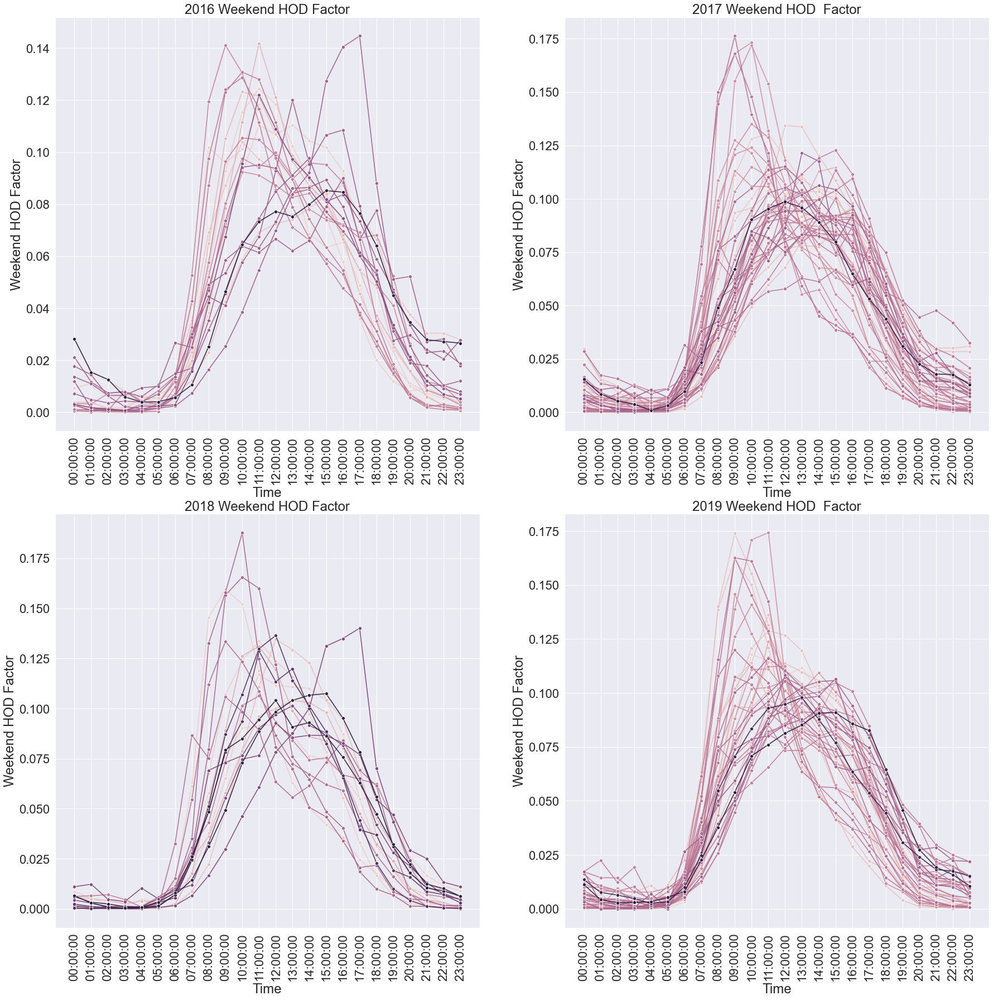

In [35]:
multiplot4_weekend(mid_s1w2)

In [36]:
mid_s1w2['ID'].nunique()

78

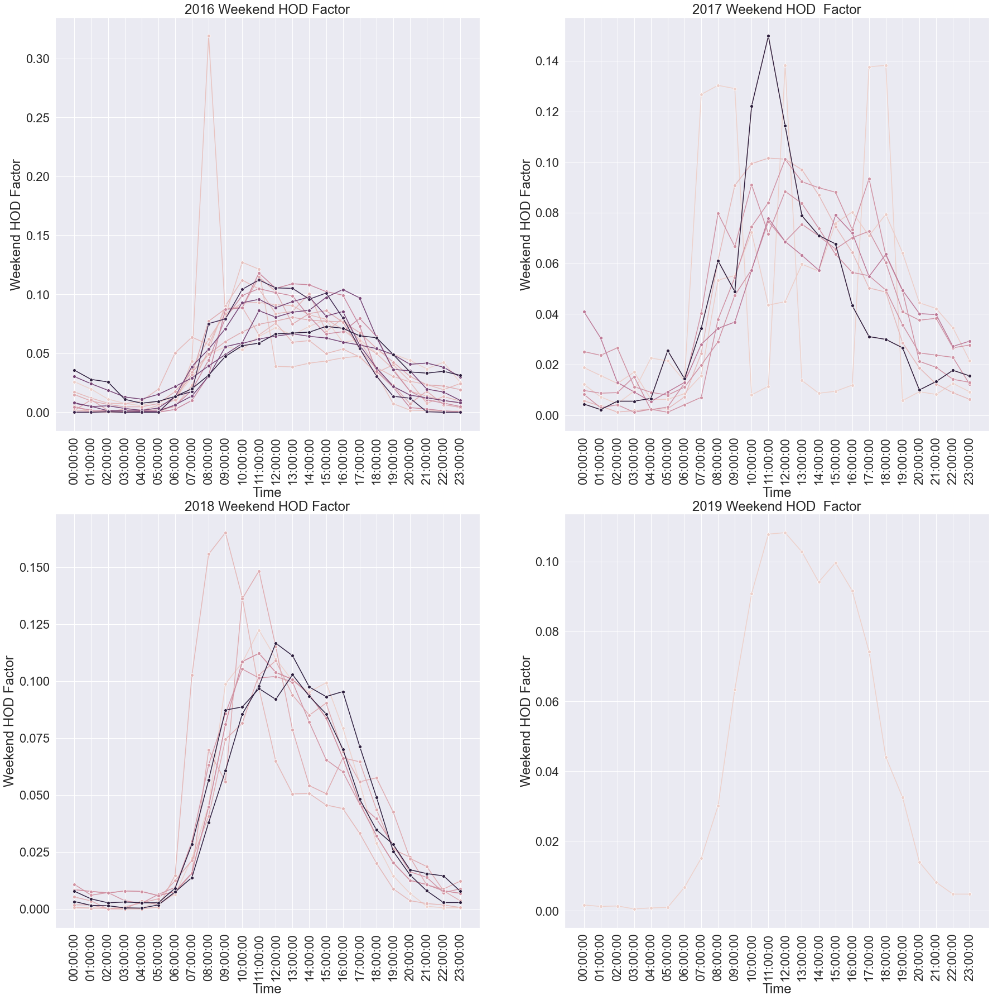

In [37]:
multiplot4_weekend(low_s1w)

# Break the HOD Factor uisng WWI index breakdonw at  0.20, 0.40 and greater than 0.40

## for Weekday

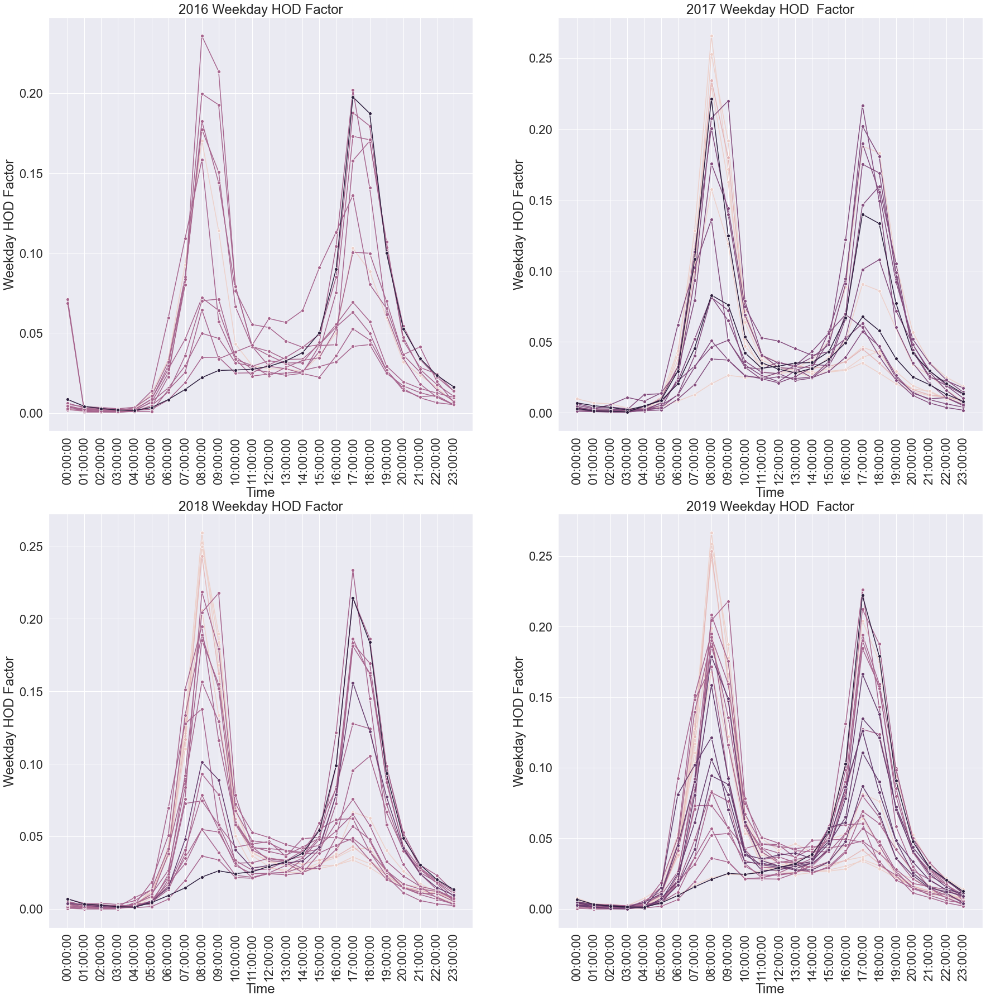

In [38]:
wd2=seasional_weekday.loc[seasional_weekday['Average_WWI']<=0.2]
multiplot4(wd2)

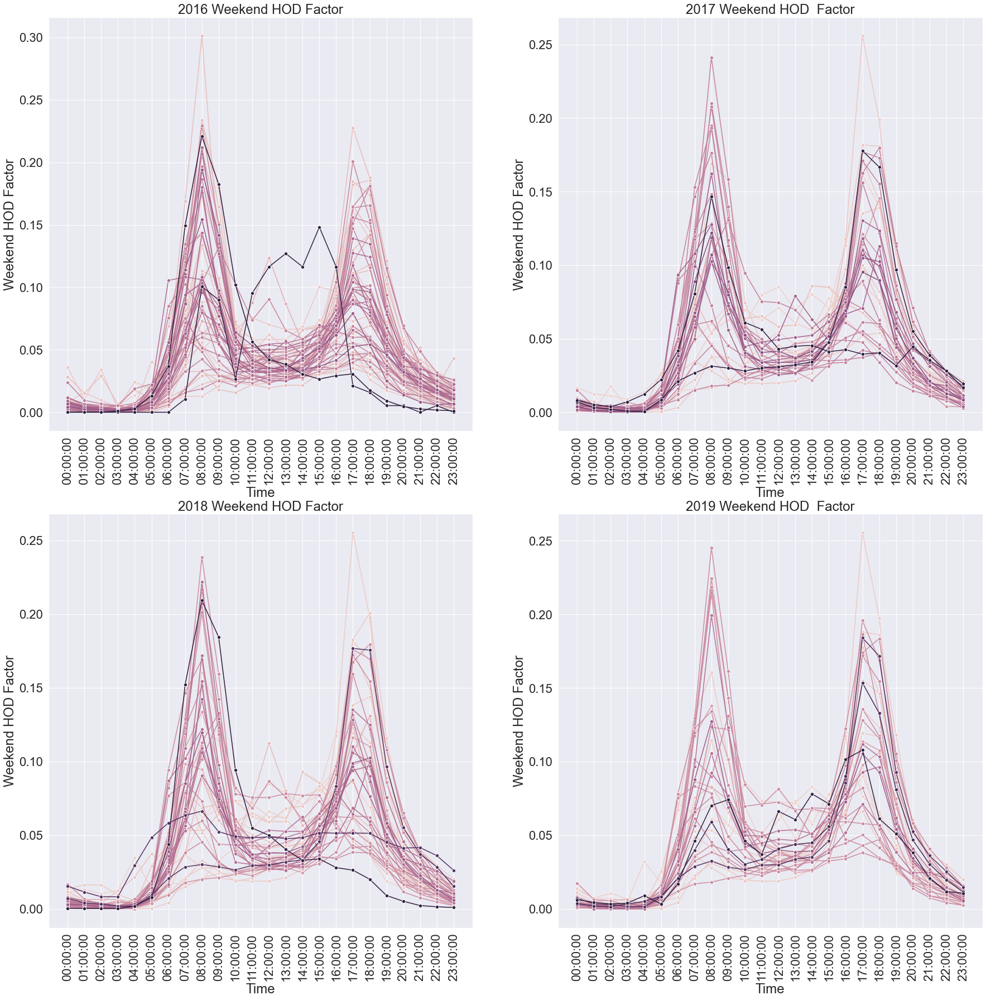

In [39]:
wd4=seasional_weekday[(seasional_weekday.Average_WWI>0.2) & (seasional_weekday.Average_WWI<=0.4)]
multiplot4_weekend(wd4)

In [40]:
# wd6=seasional_weekday[(seasional_weekday.Average_WWI>0.6) & (seasional_weekday.Average_WWI<=0.8)]
# multiplot4_weekend(wd6)

In [41]:
# wd8=seasional_weekday[(seasional_weekday.Average_WWI>0.8) & (seasional_weekday.Average_WWI<=1.0)]
# multiplot4_weekend(wd8)

In [42]:
# wd10=seasional_weekday[(seasional_weekday.Average_WWI>1.0) & (seasional_weekday.Average_WWI<=1.2)]
# multiplot4_weekend(wd10)

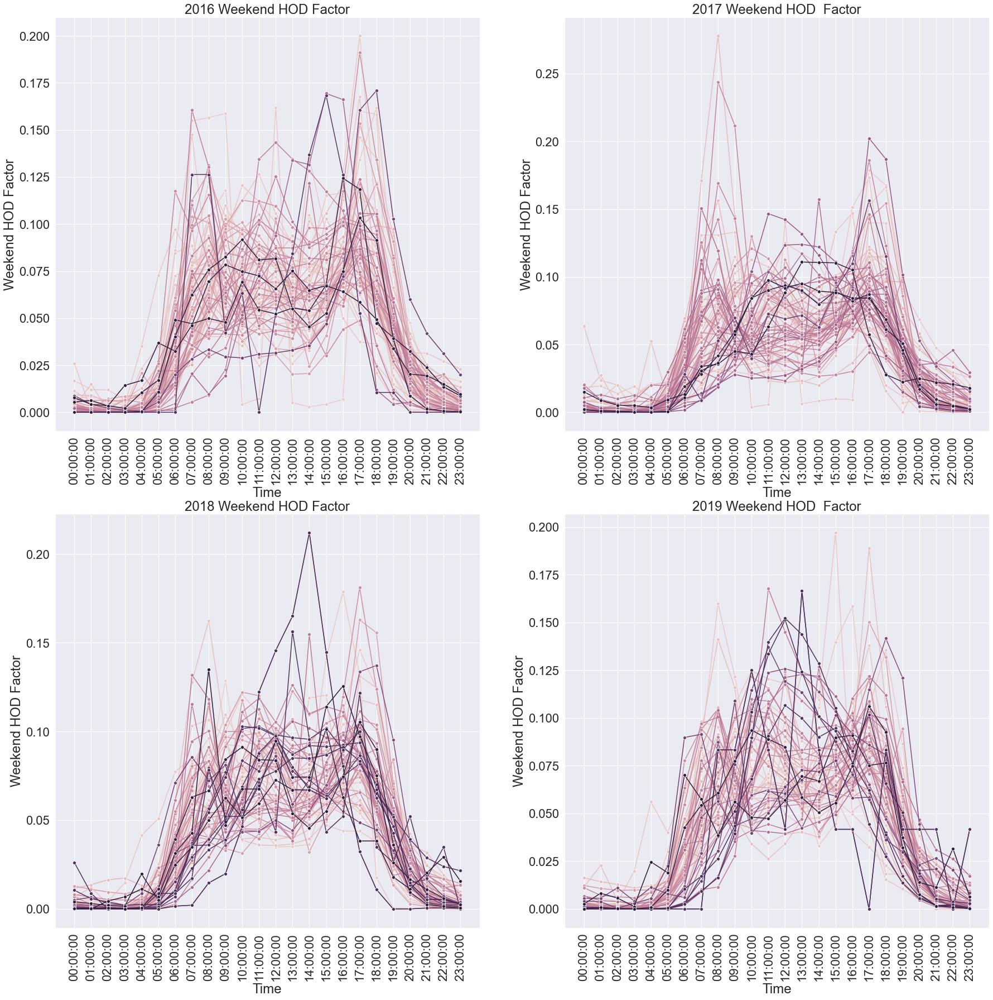

In [43]:
wd12=seasional_weekday.loc[seasional_weekday['Average_WWI']>0.4]
multiplot4_weekend(wd12)

# for weekend

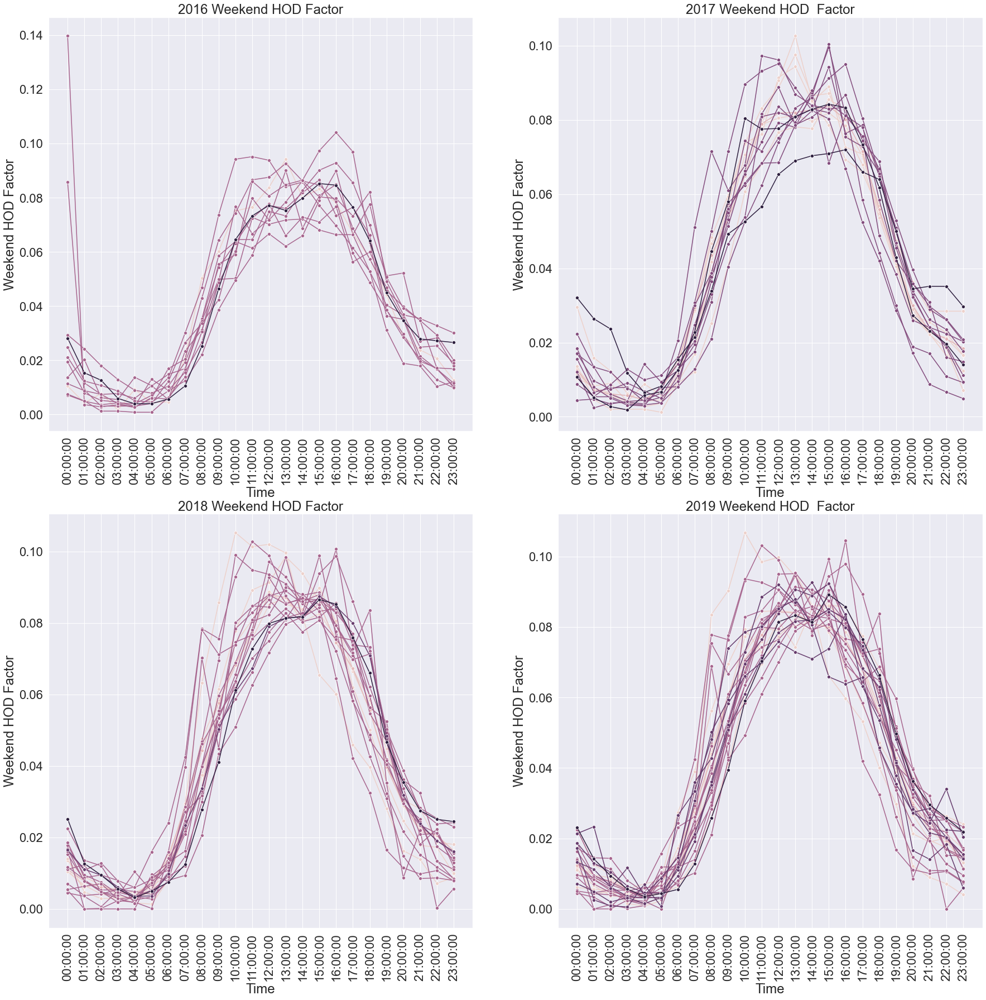

In [44]:
wnd2=seasional_weekend.loc[seasional_weekend['Average_WWI']<=0.2]
multiplot4_weekend(wnd2)

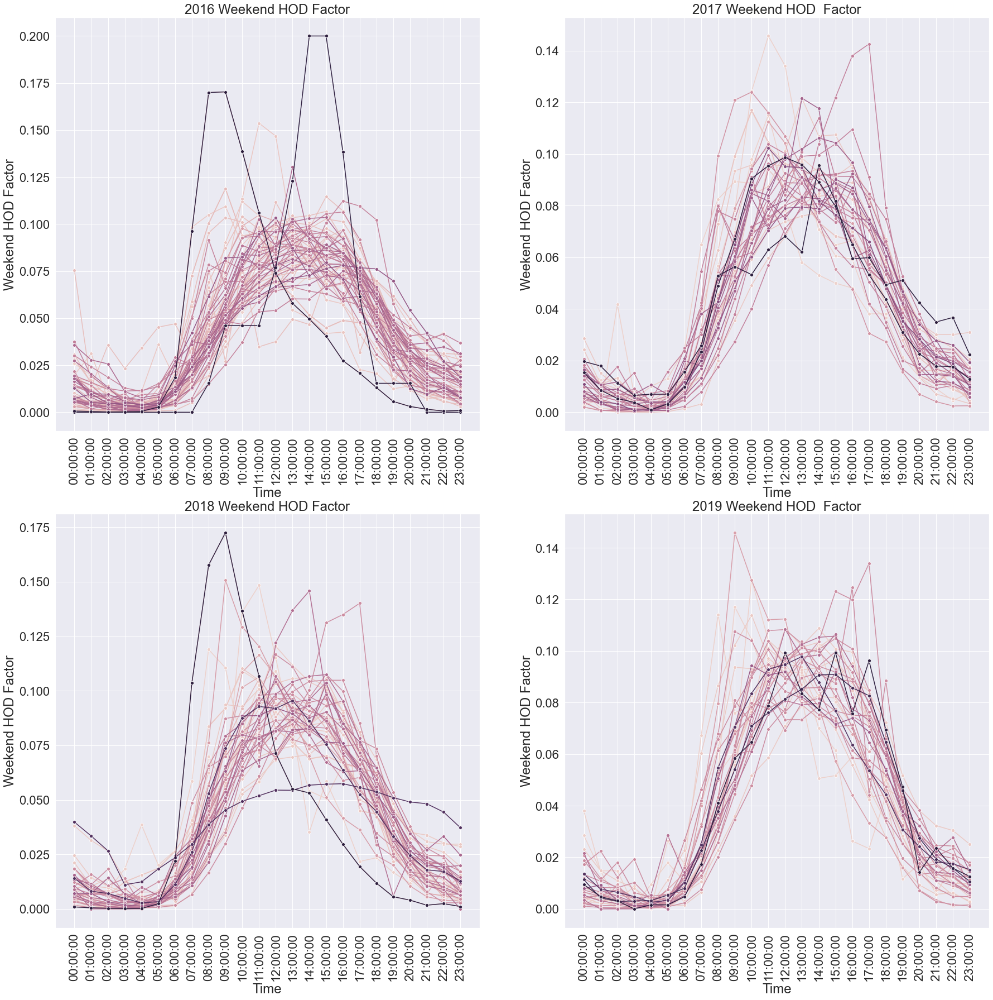

In [45]:
wnd4=seasional_weekend[(seasional_weekend.Average_WWI>0.2) & (seasional_weekend.Average_WWI<=0.4)]
multiplot4_weekend(wnd4)

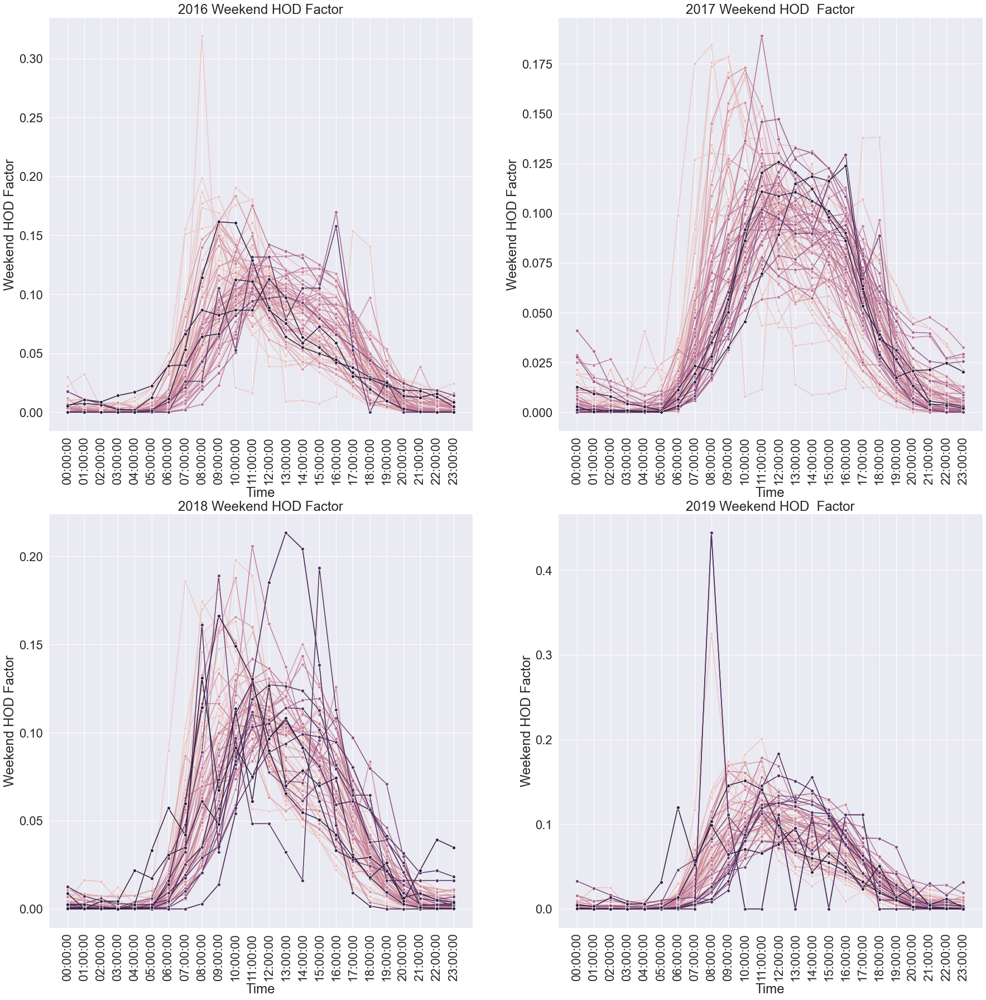

In [46]:
wnd12=seasional_weekend.loc[seasional_weekend['Average_WWI']>0.4]
multiplot4_weekend(wnd12)

# Break Down DOW Factor Pattern based on WWI Index 0.2, 0.4,0.6, 0.80 amd >1.0

In [47]:
DOW=pd.read_csv('C:/UC Berkeley Project Backup/Bike_ped Exposure Model Project/Processed Data/DOW.csv')
DOW.head()

,Unnamed: 0.1,Unnamed: 0,ID,location,latitude,longitude,year,AADBT,no_of_months_data_collected,type,Day of Week,daily_Average_volume,Average_Total_weekly_volume,DOW
0,0,0,671,urban,37.79,-122.46,2016,53.55,12,eco_permanent,Friday,42.12,374.90,0.11
1,1,0,671,urban,37.79,-122.46,2016,53.55,12,eco_permanent,Monday,44.17,374.90,0.12
2,2,0,671,urban,37.79,-122.46,2016,53.55,12,eco_permanent,Saturday,76.19,374.90,0.20
3,3,0,671,urban,37.79,-122.46,2016,53.55,12,eco_permanent,Sunday,80.45,374.90,0.21
4,4,0,671,urban,37.79,-122.46,2016,53.55,12,eco_permanent,Thursday,49.62,374.90,0.13


In [48]:
DOW.shape, ind.shape

((4935, 14), (595, 40))

In [49]:
DOW_ind=pd.merge(DOW,ind,left_on=['ID','year'],right_on=['ID','year'],how='inner')
DOW_ind.shape

(4165, 52)

In [50]:
from pandas.api.types import CategoricalDtype
cats = [ 'Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
cat_type = CategoricalDtype(categories=cats, ordered=True)
DOW_ind['Day of Week'] = DOW_ind['Day of Week'].astype(cat_type)

In [51]:
#Define plot function
# define plot function
def multiplot4_DOW(DOW_ind):
    d16=DOW_ind.loc[DOW_ind['year']==2016]
    d17=DOW_ind.loc[DOW_ind['year']==2017]
    d18=DOW_ind.loc[DOW_ind['year']==2018]
    d19=DOW_ind.loc[DOW_ind['year']==2019]
    import seaborn as sns

    sns.set(rc={'figure.figsize':(25,30)})
    sns.set(font_scale=2.0)
    import seaborn as sns


    fig, ax = plt.subplots(2,2)

    ax1 = sns.lineplot(x=d16['Day of Week'],y=d16['DOW'],hue=d16['ID'],
                       markers=True,marker="o", dashes=False,sort=True,ax=ax[0,0]) 
    plt.xticks(rotation = 'vertical')
    ax2 = sns.lineplot(x=d17['Day of Week'],y=d17['DOW'],hue=d17['ID'],
                       markers=True,marker="o", dashes=False,sort=True,ax=ax[0,1]) 
    plt.xticks(rotation = 'vertical')
    ax3 = sns.lineplot(x=d18['Day of Week'],y=d18['DOW'],hue=d18['ID'],
                       markers=True,marker="o", dashes=False,sort=True,ax=ax[1,0])
    plt.xticks(rotation = 'vertical')
    ax4 = sns.lineplot(x=d19['Day of Week'],y=d19['DOW'],hue=d19['ID'],
                       markers=True, marker="o", dashes=False,sort=True,ax=ax[1,1]) 
    ax1.get_legend().remove()
    ax2.get_legend().remove()
    ax3.get_legend().remove()
    ax4.get_legend().remove()
    ax1.title.set_text('2016 Average DOW Factor')
    ax2.title.set_text('2017 Average DOW Factor')
    ax3.title.set_text('2018 Average DOW Factor')
    ax4.title.set_text('2019 Average DOW Factor')
    plt.setp(ax1.xaxis.get_majorticklabels(), rotation=45)
    plt.setp(ax2.xaxis.get_majorticklabels(), rotation=45)
    plt.setp(ax3.xaxis.get_majorticklabels(), rotation=45)
    plt.setp(ax4.xaxis.get_majorticklabels(), rotation=45)
    ax1.set_ylabel('Average DOW Factor' )
    ax1.set_xlabel('Day of Week')
    ax2.set_ylabel('Average DOW Factor' )
    ax2.set_xlabel('Day of Week')
    ax3.set_ylabel('Average DOW Factor' )
    ax3.set_xlabel('Day of Week')
    ax4.set_ylabel('Average DOW Factor' )
    ax4.set_xlabel('Day of Week')
    plt.show()

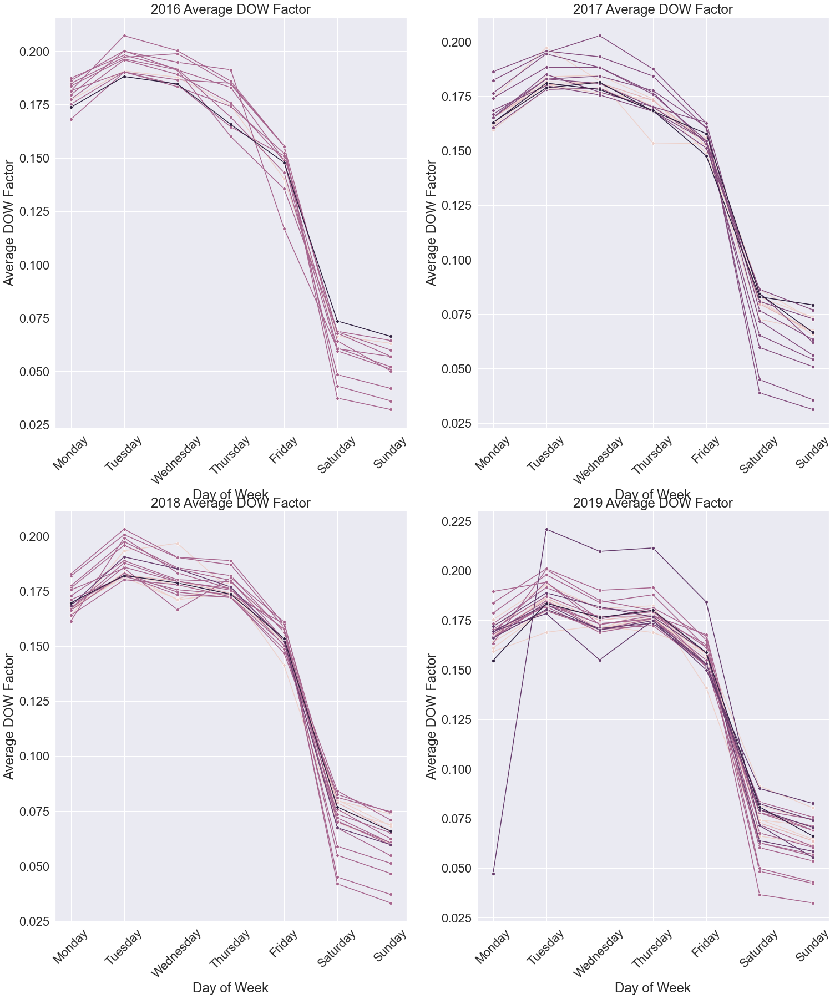

In [52]:
dow2=DOW_ind.loc[DOW_ind['Average_WWI']<=0.2]
multiplot4_DOW(dow2)

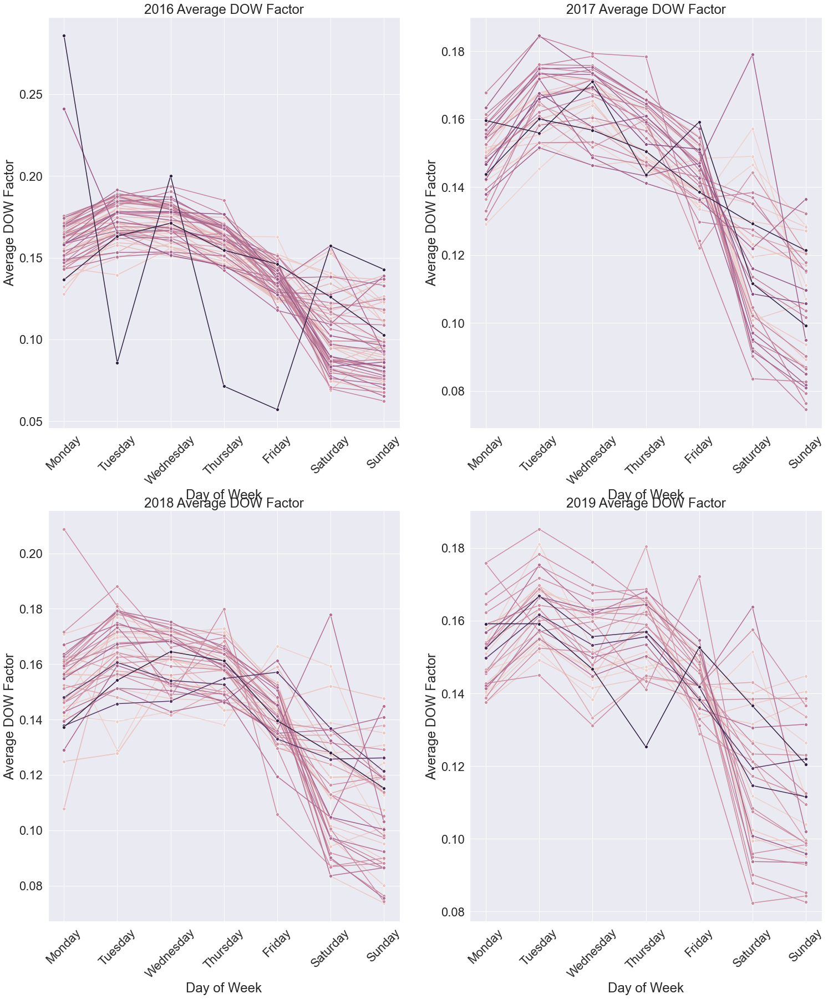

In [53]:
dow4=DOW_ind[(DOW_ind.Average_WWI>0.2) & (DOW_ind.Average_WWI<=0.4)]
multiplot4_DOW(dow4)

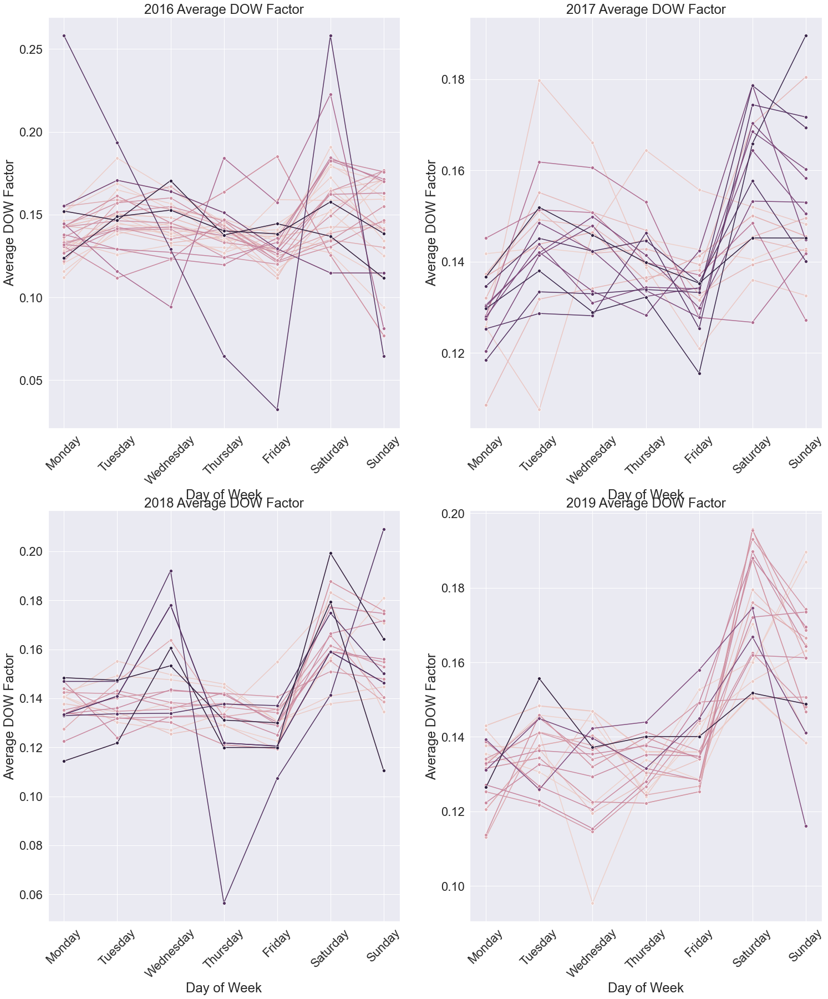

In [54]:
dow4=DOW_ind[(DOW_ind.Average_WWI>0.4) & (DOW_ind.Average_WWI<=0.6)]
multiplot4_DOW(dow4)

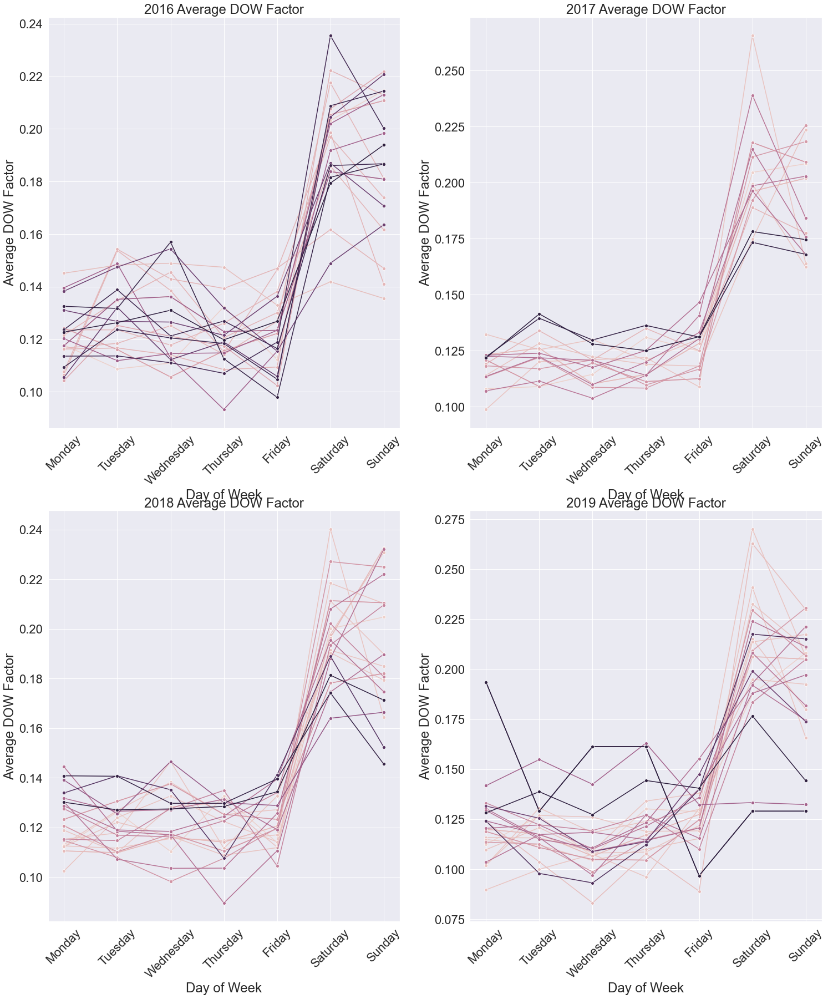

In [55]:
dow6=DOW_ind[(DOW_ind.Average_WWI>0.6) & (DOW_ind.Average_WWI<=0.8)]
multiplot4_DOW(dow6)

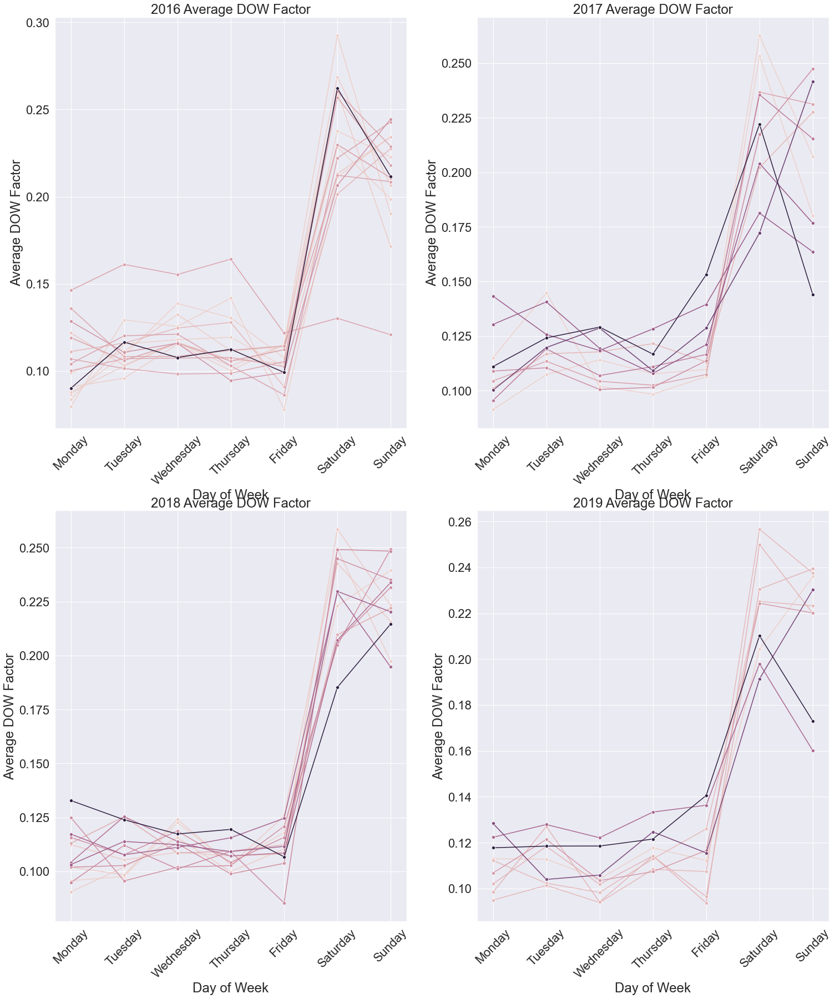

In [56]:
dow8=DOW_ind[(DOW_ind.Average_WWI>0.8) & (DOW_ind.Average_WWI<=1.0)]
multiplot4_DOW(dow8)

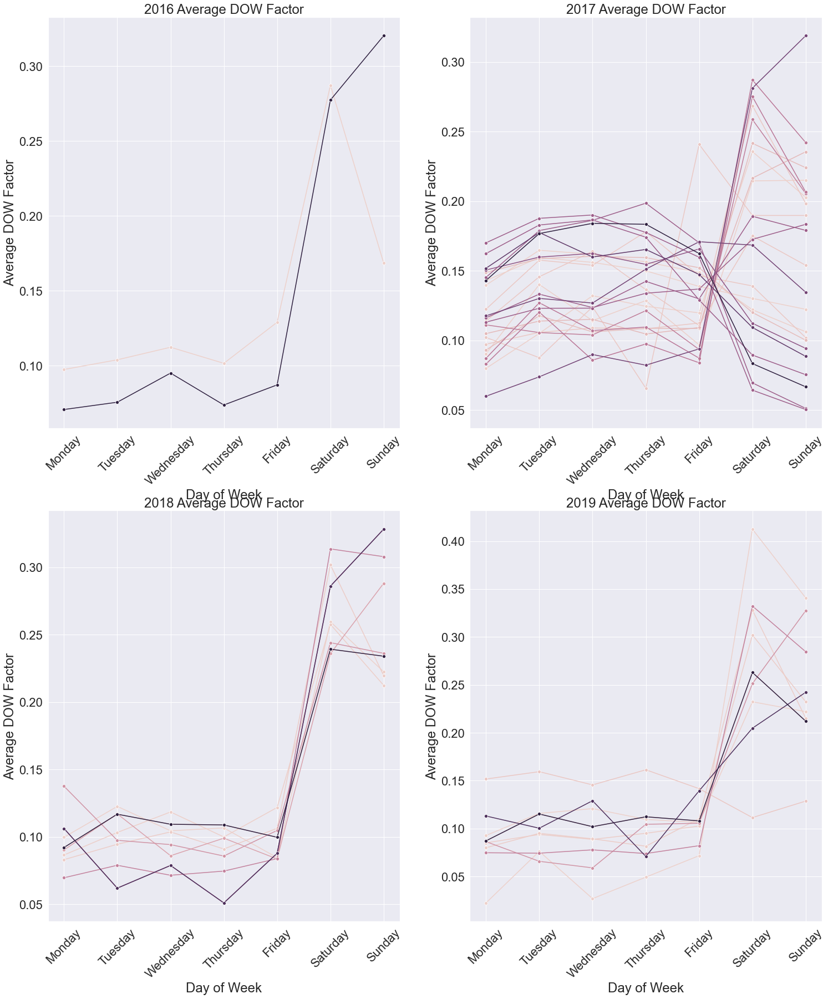

In [57]:
dow10=DOW_ind.loc[DOW_ind['Average_WWI']>1.0]
multiplot4_DOW(dow10)

# Breakdown MOY Pattern by seasonality factor

In [58]:
moy=pd.read_csv('C:/UC Berkeley Project Backup/Bike_ped Exposure Model Project/Processed Data/MOY.csv')

In [59]:
moy.columns

Index(['Unnamed: 0', 'ID', 'year', 'month', 'MTT', 'ATT', 'MOY'], dtype='object')

In [60]:
MOY_ind=pd.merge(moy,ind,left_on=['ID','year'],right_on=['ID','year'],how='inner')
MOY_ind.shape

(4624, 45)

In [61]:
check_anomally=MOY_ind.loc[MOY_ind['seasonal_factor']>3]
check_anomally

,Unnamed: 0_x,ID,year,month,MTT,ATT,MOY,Unnamed: 0.1,Max_WWI,Average_WWI,...,state,country,Unnamed: 0_y,edgeUID,osmId,stv_total,stv_com_total,stv_rec_total,stv_com_ratio,stv_rec_ratio
2216,2406,18375,2019,1,35329.00,895213.00,0.04,304,1.18,0.60,...,California,United States,125,308775307,911701772,153625.00,42870.00,110755.00,0.28,0.72
2217,2407,18375,2019,2,33223.00,895213.00,0.04,304,1.18,0.60,...,California,United States,125,308775307,911701772,153625.00,42870.00,110755.00,0.28,0.72
2218,2408,18375,2019,3,66839.00,895213.00,0.07,304,1.18,0.60,...,California,United States,125,308775307,911701772,153625.00,42870.00,110755.00,0.28,0.72
2219,2409,18375,2019,4,92944.00,895213.00,0.10,304,1.18,0.60,...,California,United States,125,308775307,911701772,153625.00,42870.00,110755.00,0.28,0.72
2220,2410,18375,2019,5,56186.00,895213.00,0.06,304,1.18,0.60,...,California,United States,125,308775307,911701772,153625.00,42870.00,110755.00,0.28,0.72
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4536,5366,51027,2018,8,2432.00,12979.00,0.19,569,3.08,0.62,...,California,United States,219,311392724,10318517,3155.00,405.00,2750.00,0.13,0.87
4537,5367,51027,2018,9,2404.00,12979.00,0.19,569,3.08,0.62,...,California,United States,219,311392724,10318517,3155.00,405.00,2750.00,0.13,0.87
4538,5368,51027,2018,10,1514.00,12979.00,0.12,569,3.08,0.62,...,California,United States,219,311392724,10318517,3155.00,405.00,2750.00,0.13,0.87
4539,5369,51027,2018,11,528.00,12979.00,0.04,569,3.08,0.62,...,California,United States,219,311392724,10318517,3155.00,405.00,2750.00,0.13,0.87


In [62]:
check_anomally['county'].unique()

array([nan, 'Douglas County', 'El Dorado County'], dtype=object)

In [63]:
MOY_ind.groupby(['year'])['ID'].nunique()

year
2016    106
2017     90
2018    101
2019     92
Name: ID, dtype: int64

In [64]:
#Define plot function
# define plot function
def multiplot4_MOY(MOY_ind):
    d16=MOY_ind.loc[MOY_ind['year']==2016]
    d17=MOY_ind.loc[MOY_ind['year']==2017]
    d18=MOY_ind.loc[MOY_ind['year']==2018]
    d19=MOY_ind.loc[MOY_ind['year']==2019]
    import seaborn as sns

    sns.set(rc={'figure.figsize':(25,30)})
    sns.set(font_scale=2.0)
    import seaborn as sns


    fig, ax = plt.subplots(2,2)

    ax1 = sns.lineplot(x=d16['month'],y=d16['MOY'],hue=d16['ID'],
                       markers=True,marker="o", dashes=False,sort=True,ax=ax[0,0]) 
    plt.xticks(rotation = 'vertical')
    ax2 = sns.lineplot(x=d17['month'],y=d17['MOY'],hue=d17['ID'],
                       markers=True,marker="o", dashes=False,sort=True,ax=ax[0,1]) 
    plt.xticks(rotation = 'vertical')
    ax3 = sns.lineplot(x=d18['month'],y=d18['MOY'],hue=d18['ID'],
                       markers=True,marker="o", dashes=False,sort=True,ax=ax[1,0])
    plt.xticks(rotation = 'vertical')
    ax4 = sns.lineplot(x=d19['month'],y=d19['MOY'],hue=d19['ID'],
                       markers=True, marker="o", dashes=False,sort=True,ax=ax[1,1]) 
    ax1.get_legend().remove()
    ax2.get_legend().remove()
    ax3.get_legend().remove()
    ax4.get_legend().remove()
    ax1.title.set_text('2016 Average MOY Factor')
    ax2.title.set_text('2017 Average MOY Factor')
    ax3.title.set_text('2018 Average MOY Factor')
    ax4.title.set_text('2019 Average MOY Factor')
    plt.setp(ax1.xaxis.get_majorticklabels(), rotation=45)
    plt.setp(ax2.xaxis.get_majorticklabels(), rotation=45)
    plt.setp(ax3.xaxis.get_majorticklabels(), rotation=45)
    plt.setp(ax4.xaxis.get_majorticklabels(), rotation=45)
    ax1.set_ylabel('Average MOY Factor' )
    ax1.set_xlabel('month')
    ax2.set_ylabel('Average MOY Factor' )
    ax2.set_xlabel('month')
    ax3.set_ylabel('Average MOY Factor' )
    ax3.set_xlabel('month')
    ax4.set_ylabel('Average MOY Factor' )
    ax4.set_xlabel('month')
    plt.show()

In [65]:
#classify the seasonal pattern
high_s1m=MOY_ind.loc[MOY_ind['seasonal_factor']>2.0]
mid_s1m = MOY_ind[(MOY_ind.seasonal_factor>1) & (MOY_ind.seasonal_factor<=1.5)]
mid_s2m = MOY_ind[(MOY_ind.seasonal_factor>1.5) & (MOY_ind.seasonal_factor<=2)]
low_s1m = MOY_ind.loc[seasional_weekday['seasonal_factor']<=1.0]
high_s1m.shape,mid_s1m.shape,mid_s2m.shape,low_s1m.shape

((461, 45), (2669, 45), (1222, 45), (336, 45))

In [66]:
high_s1m.groupby(['year'])['ID'].nunique()

year
2016     5
2017     8
2018     8
2019    18
Name: ID, dtype: int64

In [67]:
mid_s1m.groupby(['year'])['ID'].nunique()

year
2016    75
2017    44
2018    68
2019    37
Name: ID, dtype: int64

In [68]:
mid_s2m.groupby(['year'])['ID'].nunique()

year
2016    14
2017    35
2018    17
2019    37
Name: ID, dtype: int64

In [69]:
low_s1m.groupby(['year'])['ID'].nunique()

year
2016    12
2017    10
2018    12
2019     8
Name: ID, dtype: int64

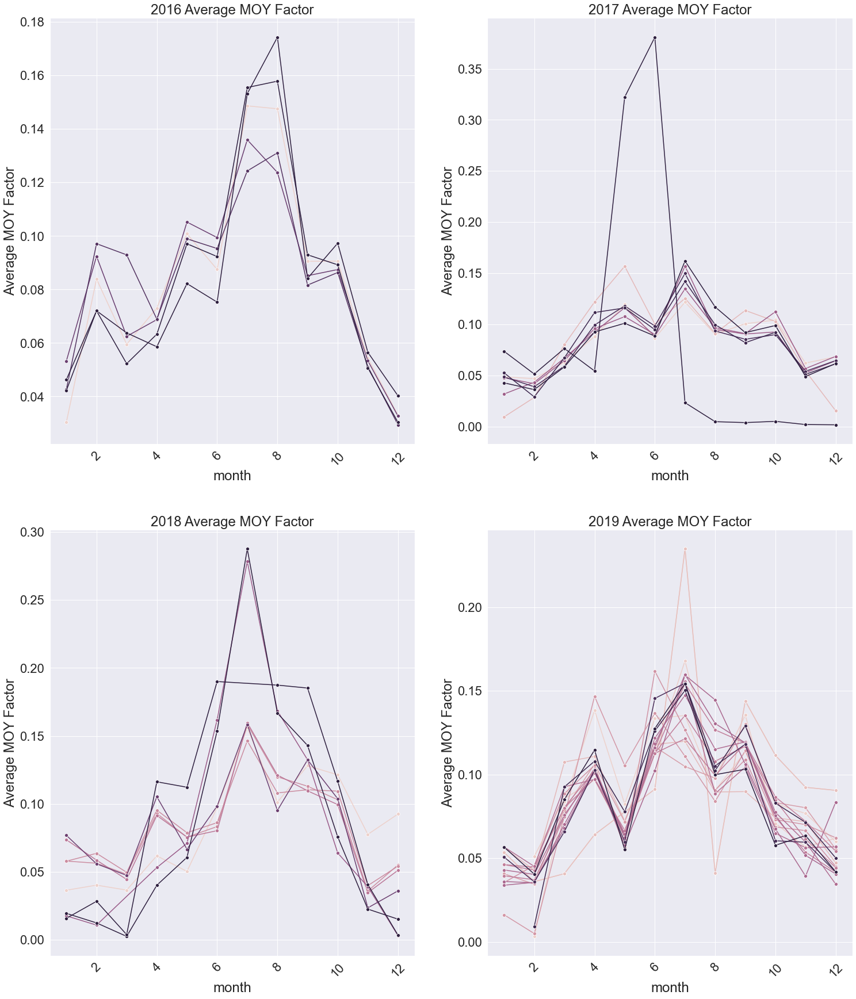

In [70]:
multiplot4_MOY(high_s1m)

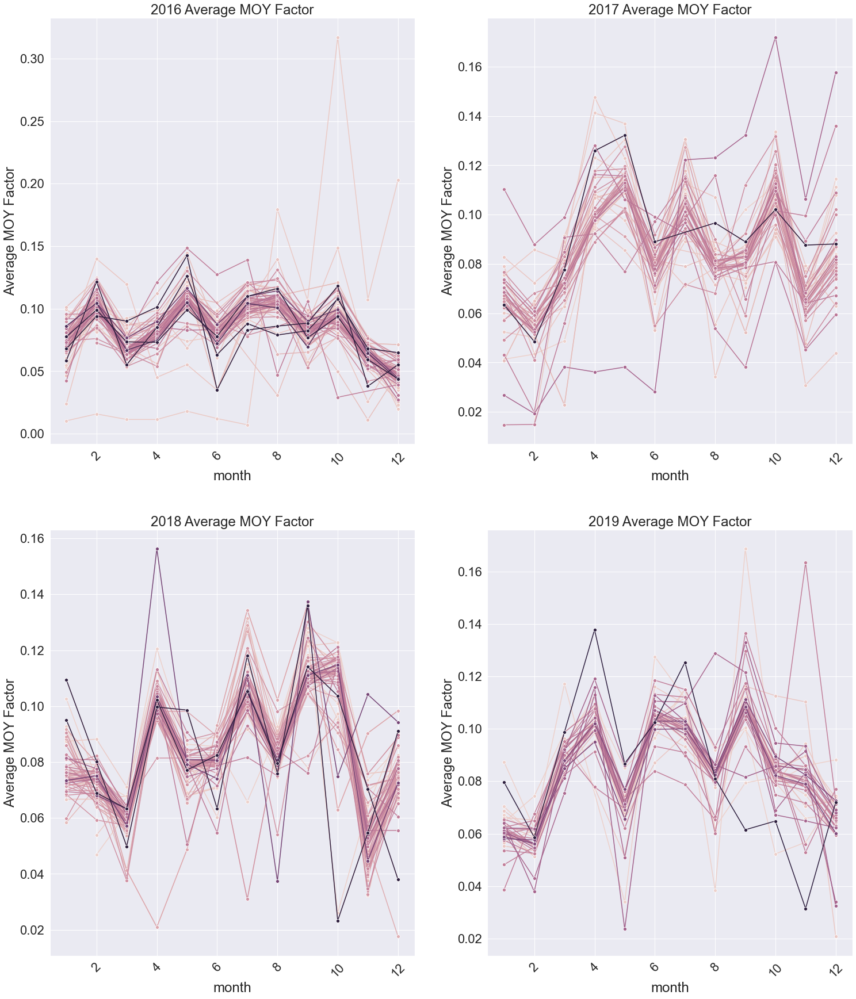

In [71]:
multiplot4_MOY(mid_s1m)

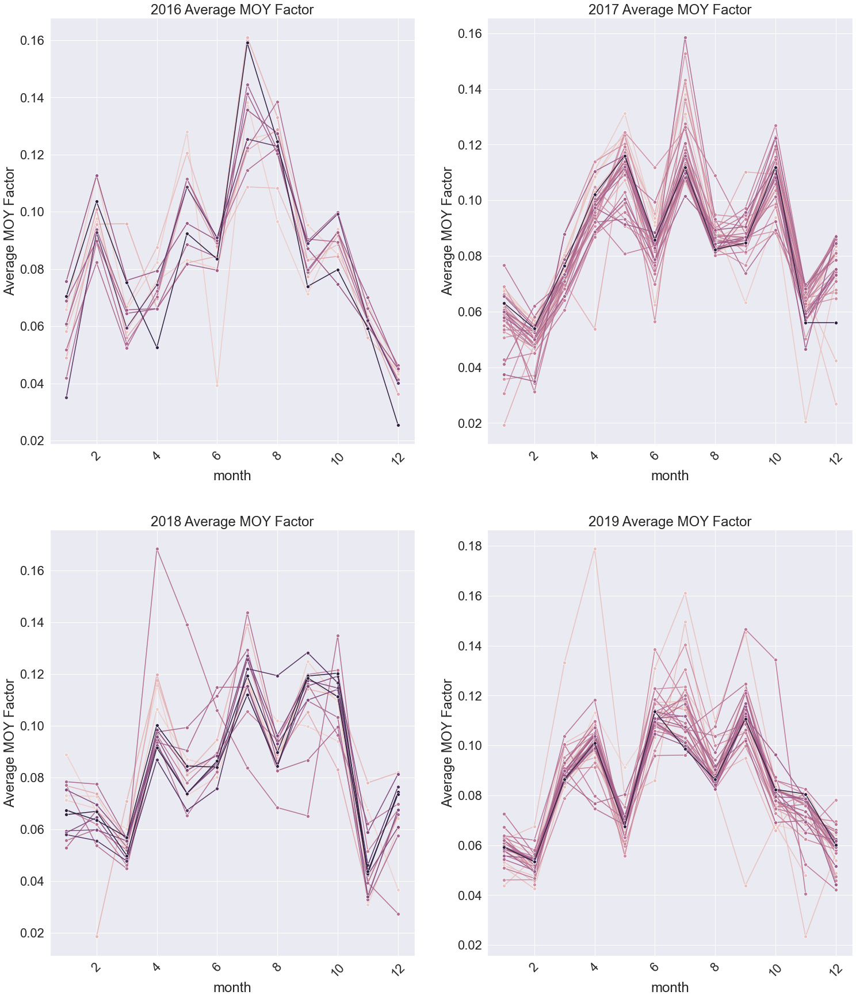

In [72]:
multiplot4_MOY(mid_s2m)

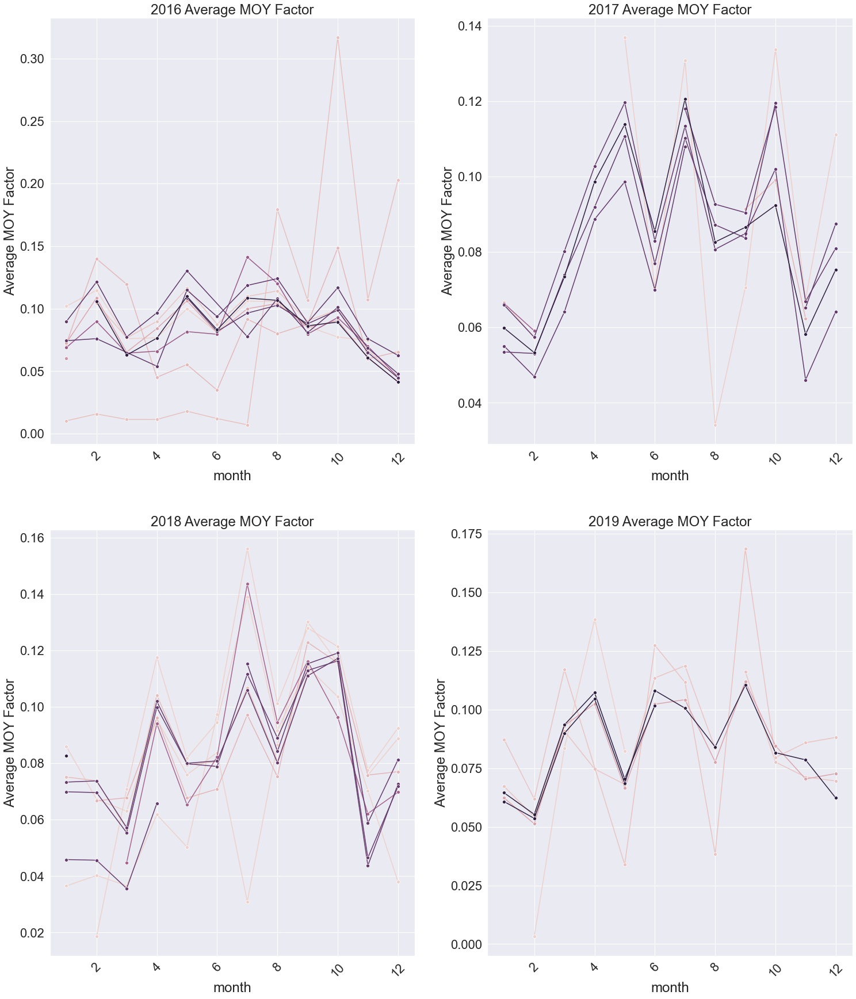

In [73]:
multiplot4_MOY(low_s1m)

# End of the Code